# Afriat

In [1]:
scan=0.05

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

True

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{0.1}"
)

vae.save(
    dir_path,
    overwrite=True,
)

CUDA backend failed to initialize: Found cuDNN version 8700, but JAX was built against version 8907, which is newer. The copy of cuDNN that is installed must be at least as new as the version against which JAX was built. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: yzjw34d0
Name: lively-star-106
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/yzjw34d0
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_101835-yzjw34d0/files



GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


You are using a CUDA device ('NVIDIA A100-PCIE-40GB MIG 3g.20gb') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [MIG-0de29bde-f76b-595f-a0fb-97c2b800da3a]


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                             | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2537,3271,9435
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2537,2575,1701,3421,1648,3361
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4517,10726
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 668,838,2304
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 668,627,407,869,401,838
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1067,2743
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                  | 1/600 [00:12<2:07:07, 12.73s/it]

Epoch 1/600:   0%|▎                                                                                                                                                       | 1/600 [00:12<2:07:07, 12.73s/it, v_num=d0_1, total_loss_train=3.71e+3, kl_local_train=45.7]

Epoch 2/600:   0%|▎                                                                                                                                                       | 1/600 [00:12<2:07:07, 12.73s/it, v_num=d0_1, total_loss_train=3.71e+3, kl_local_train=45.7]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:19<1:31:14,  9.15s/it, v_num=d0_1, total_loss_train=3.71e+3, kl_local_train=45.7]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:19<1:31:14,  9.15s/it, v_num=d0_1, total_loss_train=3.23e+3, kl_local_train=60.5]

Epoch 3/600:   0%|▌                                                                                                                                                       | 2/600 [00:19<1:31:14,  9.15s/it, v_num=d0_1, total_loss_train=3.23e+3, kl_local_train=60.5]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:25<1:19:07,  7.95s/it, v_num=d0_1, total_loss_train=3.23e+3, kl_local_train=60.5]

Epoch 3/600:   0%|▊                                                                                                                                                         | 3/600 [00:25<1:19:07,  7.95s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=59]

Epoch 4/600:   0%|▊                                                                                                                                                         | 3/600 [00:25<1:19:07,  7.95s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=59]

Epoch 4/600:   1%|█                                                                                                                                                         | 4/600 [00:31<1:09:50,  7.03s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=59]

Epoch 4/600:   1%|█                                                                                                                                                       | 4/600 [00:31<1:09:50,  7.03s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=54.1]

Epoch 5/600:   1%|█                                                                                                                                                       | 4/600 [00:31<1:09:50,  7.03s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=54.1]

Epoch 5/600:   1%|█▎                                                                                                                                                      | 5/600 [00:37<1:04:38,  6.52s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=54.1]

Epoch 5/600:   1%|█▎                                                                                                                                                      | 5/600 [00:37<1:04:38,  6.52s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=46.1]

Epoch 6/600:   1%|█▎                                                                                                                                                      | 5/600 [00:38<1:04:38,  6.52s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=46.1]

Epoch 6/600:   1%|█▌                                                                                                                                                      | 6/600 [00:44<1:07:47,  6.85s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=46.1]

Epoch 6/600:   1%|▏                   | 6/600 [00:44<1:07:47,  6.85s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=33.4, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|▏                   | 6/600 [00:44<1:07:47,  6.85s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=33.4, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|▏                   | 7/600 [00:51<1:07:36,  6.84s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=33.4, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|▎                     | 7/600 [00:51<1:07:36,  6.84s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=32, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▎                     | 7/600 [00:51<1:07:36,  6.84s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=32, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▎                     | 8/600 [00:58<1:06:56,  6.79s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=32, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▎                   | 8/600 [00:58<1:06:56,  6.79s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 9/600:   1%|▎                   | 8/600 [00:58<1:06:56,  6.79s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▎                   | 9/600 [01:03<1:03:20,  6.43s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▎                   | 9/600 [01:03<1:03:20,  6.43s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=29.6, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▎                  | 9/600 [01:03<1:03:20,  6.43s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=29.6, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▎                 | 10/600 [01:10<1:03:39,  6.47s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=29.6, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▎                 | 10/600 [01:10<1:03:39,  6.47s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▎                 | 10/600 [01:11<1:03:39,  6.47s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▎                 | 11/600 [01:16<1:04:02,  6.52s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00965, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▎                  | 11/600 [01:16<1:04:02,  6.52s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=32.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 12/600:   2%|▎                  | 11/600 [01:16<1:04:02,  6.52s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=32.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 12/600:   2%|▍                  | 12/600 [01:22<1:00:46,  6.20s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=32.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 12/600:   2%|▍                    | 12/600 [01:22<1:00:46,  6.20s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=35, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 13/600:   2%|▍                    | 12/600 [01:22<1:00:46,  6.20s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=35, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 13/600:   2%|▍                      | 13/600 [01:28<59:03,  6.04s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=35, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 13/600:   2%|▍                      | 13/600 [01:28<59:03,  6.04s/it, v_num=d0_1, total_loss_train=3169.25, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 14/600:   2%|▍                      | 13/600 [01:28<59:03,  6.04s/it, v_num=d0_1, total_loss_train=3169.25, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 14/600:   2%|▍                    | 14/600 [01:34<1:00:17,  6.17s/it, v_num=d0_1, total_loss_train=3169.25, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 14/600:   2%|▍                  | 14/600 [01:34<1:00:17,  6.17s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 15/600:   2%|▍                  | 14/600 [01:34<1:00:17,  6.17s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 15/600:   2%|▍                  | 15/600 [01:41<1:01:00,  6.26s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 15/600:   2%|▍                  | 15/600 [01:41<1:01:00,  6.26s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 16/600:   2%|▍                  | 15/600 [01:42<1:01:00,  6.26s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 16/600:   3%|▌                  | 16/600 [01:47<1:01:31,  6.32s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0202, metric_mi|mouse_train=0.0473]

Epoch 16/600:   3%|▌                  | 16/600 [01:47<1:01:31,  6.32s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 17/600:   3%|▌                  | 16/600 [01:47<1:01:31,  6.32s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 17/600:   3%|▌                  | 17/600 [01:54<1:02:09,  6.40s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 17/600:   3%|▌                  | 17/600 [01:54<1:02:09,  6.40s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 18/600:   3%|▌                  | 17/600 [01:54<1:02:09,  6.40s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 18/600:   3%|▋                    | 18/600 [01:59<59:52,  6.17s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 18/600:   3%|▋                    | 18/600 [01:59<59:52,  6.17s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 19/600:   3%|▋                    | 18/600 [01:59<59:52,  6.17s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 19/600:   3%|▋                    | 19/600 [02:05<58:17,  6.02s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 19/600:   3%|▋                    | 19/600 [02:05<58:17,  6.02s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 20/600:   3%|▋                    | 19/600 [02:05<58:17,  6.02s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 20/600:   3%|▋                    | 20/600 [02:11<57:07,  5.91s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 20/600:   3%|▋                    | 20/600 [02:11<57:07,  5.91s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=59.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 21/600:   3%|▋                    | 20/600 [02:12<57:07,  5.91s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=59.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 21/600:   4%|▋                  | 21/600 [02:18<1:01:16,  6.35s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=59.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0721]

Epoch 21/600:   4%|▋                   | 21/600 [02:18<1:01:16,  6.35s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 22/600:   4%|▋                   | 21/600 [02:18<1:01:16,  6.35s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 22/600:   4%|▊                     | 22/600 [02:24<59:07,  6.14s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 22/600:   4%|▊                     | 22/600 [02:24<59:07,  6.14s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=66.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 23/600:   4%|▊                     | 22/600 [02:24<59:07,  6.14s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=66.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 23/600:   4%|▊                   | 23/600 [02:30<1:00:13,  6.26s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=66.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 23/600:   4%|▊                   | 23/600 [02:30<1:00:13,  6.26s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=68.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 24/600:   4%|▊                   | 23/600 [02:30<1:00:13,  6.26s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=68.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 24/600:   4%|▉                     | 24/600 [02:36<58:09,  6.06s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=68.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 24/600:   4%|▉                       | 24/600 [02:36<58:09,  6.06s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=71, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 25/600:   4%|▉                       | 24/600 [02:36<58:09,  6.06s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=71, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 25/600:   4%|█                       | 25/600 [02:41<56:43,  5.92s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=71, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 25/600:   4%|▉                     | 25/600 [02:41<56:43,  5.92s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=74.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 26/600:   4%|▉                     | 25/600 [02:43<56:43,  5.92s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=74.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 26/600:   4%|▊                   | 26/600 [02:49<1:02:38,  6.55s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=74.2, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0714]

Epoch 26/600:   4%|▊                  | 26/600 [02:49<1:02:38,  6.55s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=77.8, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 27/600:   4%|▊                  | 26/600 [02:49<1:02:38,  6.55s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=77.8, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 27/600:   4%|▉                    | 27/600 [02:55<59:59,  6.28s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=77.8, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 27/600:   4%|▉                    | 27/600 [02:55<59:59,  6.28s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 28/600:   4%|▉                    | 27/600 [02:55<59:59,  6.28s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 28/600:   5%|▉                  | 28/600 [03:02<1:00:55,  6.39s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 28/600:   5%|▉                  | 28/600 [03:02<1:00:55,  6.39s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=80.5, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 29/600:   5%|▉                  | 28/600 [03:02<1:00:55,  6.39s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=80.5, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 29/600:   5%|▉                  | 29/600 [03:09<1:04:12,  6.75s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=80.5, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 29/600:   5%|█                    | 29/600 [03:09<1:04:12,  6.75s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 30/600:   5%|█                    | 29/600 [03:09<1:04:12,  6.75s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 30/600:   5%|█                    | 30/600 [03:15<1:00:58,  6.42s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 30/600:   5%|▉                  | 30/600 [03:15<1:00:58,  6.42s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=82.5, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 31/600:   5%|▉                  | 30/600 [03:16<1:00:58,  6.42s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=82.5, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 31/600:   5%|▉                  | 31/600 [03:22<1:01:44,  6.51s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=82.5, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0751]

Epoch 31/600:   5%|▉                  | 31/600 [03:22<1:01:44,  6.51s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=82.6, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 32/600:   5%|▉                  | 31/600 [03:22<1:01:44,  6.51s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=82.6, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 32/600:   5%|█                    | 32/600 [03:27<59:14,  6.26s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=82.6, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 32/600:   5%|█                    | 32/600 [03:27<59:14,  6.26s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 33/600:   5%|█                    | 32/600 [03:27<59:14,  6.26s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 33/600:   6%|█▏                   | 33/600 [03:33<57:27,  6.08s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 33/600:   6%|█▏                   | 33/600 [03:33<57:27,  6.08s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=86.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 34/600:   6%|█▏                   | 33/600 [03:33<57:27,  6.08s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=86.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 34/600:   6%|█▏                   | 34/600 [03:38<55:50,  5.92s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=86.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 34/600:   6%|█▏                   | 34/600 [03:38<55:50,  5.92s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=86.4, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 35/600:   6%|█▏                   | 34/600 [03:38<55:50,  5.92s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=86.4, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 35/600:   6%|█▏                   | 35/600 [03:45<57:22,  6.09s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=86.4, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 35/600:   6%|█▏                   | 35/600 [03:45<57:22,  6.09s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=84.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 36/600:   6%|█▏                   | 35/600 [03:46<57:22,  6.09s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=84.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 36/600:   6%|█▎                   | 36/600 [03:52<58:49,  6.26s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=84.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0814]

Epoch 36/600:   6%|█▎                    | 36/600 [03:52<58:49,  6.26s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 37/600:   6%|█▎                    | 36/600 [03:52<58:49,  6.26s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 37/600:   6%|█▎                    | 37/600 [03:57<57:04,  6.08s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 37/600:   6%|█▎                    | 37/600 [03:57<57:04,  6.08s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=86.1, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 38/600:   6%|█▎                    | 37/600 [03:57<57:04,  6.08s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=86.1, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 38/600:   6%|█▍                    | 38/600 [04:03<55:49,  5.96s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=86.1, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 38/600:   6%|█▍                    | 38/600 [04:03<55:49,  5.96s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=85.2, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 39/600:   6%|█▍                    | 38/600 [04:03<55:49,  5.96s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=85.2, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 39/600:   6%|█▍                    | 39/600 [04:09<57:24,  6.14s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=85.2, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 39/600:   6%|█▍                    | 39/600 [04:09<57:24,  6.14s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 40/600:   6%|█▍                    | 39/600 [04:10<57:24,  6.14s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 40/600:   7%|█▍                    | 40/600 [04:16<58:12,  6.24s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 40/600:   7%|█▍                    | 40/600 [04:16<58:12,  6.24s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 41/600:   7%|█▍                    | 40/600 [04:17<58:12,  6.24s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 41/600:   7%|█▎                  | 41/600 [04:24<1:01:50,  6.64s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0879]

Epoch 41/600:   7%|█▎                 | 41/600 [04:24<1:01:50,  6.64s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 42/600:   7%|█▎                 | 41/600 [04:24<1:01:50,  6.64s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 42/600:   7%|█▎                 | 42/600 [04:30<1:01:30,  6.61s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 42/600:   7%|█▍                  | 42/600 [04:30<1:01:30,  6.61s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 43/600:   7%|█▍                  | 42/600 [04:30<1:01:30,  6.61s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 43/600:   7%|█▌                    | 43/600 [04:36<58:18,  6.28s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 43/600:   7%|█▌                    | 43/600 [04:36<58:18,  6.28s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=83.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 44/600:   7%|█▌                    | 43/600 [04:36<58:18,  6.28s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=83.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 44/600:   7%|█▌                    | 44/600 [04:41<56:33,  6.10s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=83.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 44/600:   7%|█▌                    | 44/600 [04:41<56:33,  6.10s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=84.1, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 45/600:   7%|█▌                    | 44/600 [04:41<56:33,  6.10s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=84.1, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 45/600:   8%|█▋                    | 45/600 [04:48<57:20,  6.20s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=84.1, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 45/600:   8%|█▋                    | 45/600 [04:48<57:20,  6.20s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=83.6, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 46/600:   8%|█▋                    | 45/600 [04:49<57:20,  6.20s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=83.6, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 46/600:   8%|█▋                    | 46/600 [04:55<59:02,  6.39s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=83.6, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0486, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0909]

Epoch 46/600:   8%|█▋                    | 46/600 [04:55<59:02,  6.39s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 47/600:   8%|█▋                    | 46/600 [04:55<59:02,  6.39s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 47/600:   8%|█▋                    | 47/600 [05:00<57:09,  6.20s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 47/600:   8%|█▋                    | 47/600 [05:00<57:09,  6.20s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=82.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 48/600:   8%|█▋                    | 47/600 [05:00<57:09,  6.20s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=82.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 48/600:   8%|█▊                    | 48/600 [05:06<56:01,  6.09s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=82.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 48/600:   8%|█▊                    | 48/600 [05:06<56:01,  6.09s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=82.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 49/600:   8%|█▊                    | 48/600 [05:06<56:01,  6.09s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=82.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 49/600:   8%|█▊                    | 49/600 [05:13<58:11,  6.34s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=82.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 49/600:   8%|█▊                    | 49/600 [05:13<58:11,  6.34s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=81.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 50/600:   8%|█▊                    | 49/600 [05:13<58:11,  6.34s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=81.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 50/600:   8%|█▊                    | 50/600 [05:19<55:50,  6.09s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=81.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 50/600:   8%|██                      | 50/600 [05:19<55:50,  6.09s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=81, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 51/600:   8%|██                      | 50/600 [05:20<55:50,  6.09s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=81, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 51/600:   8%|██                      | 51/600 [05:25<56:39,  6.19s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=81, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0922]

Epoch 51/600:   8%|█▊                    | 51/600 [05:25<56:39,  6.19s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=79.1, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 52/600:   8%|█▊                    | 51/600 [05:25<56:39,  6.19s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=79.1, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 52/600:   9%|█▉                    | 52/600 [05:31<55:40,  6.10s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=79.1, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 52/600:   9%|██                      | 52/600 [05:31<55:40,  6.10s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=78, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 53/600:   9%|██                      | 52/600 [05:31<55:40,  6.10s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=78, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 53/600:   9%|██                      | 53/600 [05:37<55:15,  6.06s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=78, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 53/600:   9%|█▉                    | 53/600 [05:37<55:15,  6.06s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 54/600:   9%|█▉                    | 53/600 [05:37<55:15,  6.06s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 54/600:   9%|█▉                    | 54/600 [05:43<56:14,  6.18s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 54/600:   9%|█▉                    | 54/600 [05:43<56:14,  6.18s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=77.1, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 55/600:   9%|█▉                    | 54/600 [05:43<56:14,  6.18s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=77.1, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 55/600:   9%|██                    | 55/600 [05:50<57:24,  6.32s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=77.1, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 55/600:   9%|██                    | 55/600 [05:50<57:24,  6.32s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=75.6, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 56/600:   9%|██                    | 55/600 [05:51<57:24,  6.32s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=75.6, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 56/600:   9%|██                    | 56/600 [05:56<57:43,  6.37s/it, v_num=d0_1, total_loss_train=3.21e+3, kl_local_train=75.6, metric_mi|status_control_train=0.0821, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.095]

Epoch 56/600:   9%|██▏                    | 56/600 [05:56<57:43,  6.37s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=75.4, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 57/600:   9%|██▏                    | 56/600 [05:56<57:43,  6.37s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=75.4, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 57/600:  10%|██▏                    | 57/600 [06:02<55:10,  6.10s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=75.4, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 57/600:  10%|██▏                    | 57/600 [06:02<55:10,  6.10s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=73.8, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 58/600:  10%|██▏                    | 57/600 [06:02<55:10,  6.10s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=73.8, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 58/600:  10%|██▏                    | 58/600 [06:08<56:00,  6.20s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=73.8, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 58/600:  10%|██▏                    | 58/600 [06:08<56:00,  6.20s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=73.6, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 59/600:  10%|██▏                    | 58/600 [06:08<56:00,  6.20s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=73.6, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 59/600:  10%|██▎                    | 59/600 [06:14<53:59,  5.99s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=73.6, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 59/600:  10%|██▎                    | 59/600 [06:14<53:59,  5.99s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=72.9, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 60/600:  10%|██▎                    | 59/600 [06:14<53:59,  5.99s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=72.9, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 60/600:  10%|██▎                    | 60/600 [06:20<55:36,  6.18s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=72.9, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 60/600:  10%|██▎                    | 60/600 [06:20<55:36,  6.18s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=72.1, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 61/600:  10%|██▎                    | 60/600 [06:21<55:36,  6.18s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=72.1, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 61/600:  10%|██▎                    | 61/600 [06:27<56:18,  6.27s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=72.1, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0937]

Epoch 61/600:  10%|██▎                    | 61/600 [06:27<56:18,  6.27s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 62/600:  10%|██▎                    | 61/600 [06:27<56:18,  6.27s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 62/600:  10%|██▍                    | 62/600 [06:32<53:50,  6.00s/it, v_num=d0_1, total_loss_train=3.2e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 62/600:  10%|██▎                   | 62/600 [06:32<53:50,  6.00s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=70.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 63/600:  10%|██▎                   | 62/600 [06:32<53:50,  6.00s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=70.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 63/600:  10%|██▎                   | 63/600 [06:38<54:11,  6.06s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=70.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 63/600:  10%|██▎                   | 63/600 [06:38<54:11,  6.06s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=69.7, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 64/600:  10%|██▎                   | 63/600 [06:39<54:11,  6.06s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=69.7, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 64/600:  11%|██▎                   | 64/600 [06:44<52:43,  5.90s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=69.7, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 64/600:  11%|██▎                   | 64/600 [06:44<52:43,  5.90s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=69.1, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 65/600:  11%|██▎                   | 64/600 [06:44<52:43,  5.90s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=69.1, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 65/600:  11%|██▍                   | 65/600 [06:50<54:06,  6.07s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=69.1, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 65/600:  11%|██▍                   | 65/600 [06:50<54:06,  6.07s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 66/600:  11%|██▍                   | 65/600 [06:52<54:06,  6.07s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 66/600:  11%|██▍                   | 66/600 [06:57<54:54,  6.17s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0932]

Epoch 66/600:  11%|██▍                   | 66/600 [06:57<54:54,  6.17s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=68.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 67/600:  11%|██▍                   | 66/600 [06:57<54:54,  6.17s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=68.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 67/600:  11%|██▍                   | 67/600 [07:02<52:45,  5.94s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=68.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 67/600:  11%|██▍                   | 67/600 [07:02<52:45,  5.94s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=67.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 68/600:  11%|██▍                   | 67/600 [07:02<52:45,  5.94s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=67.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 68/600:  11%|██▍                   | 68/600 [07:08<51:15,  5.78s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=67.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 68/600:  11%|██▍                   | 68/600 [07:08<51:15,  5.78s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=66.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 69/600:  11%|██▍                   | 68/600 [07:08<51:15,  5.78s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=66.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 69/600:  12%|██▌                   | 69/600 [07:14<52:48,  5.97s/it, v_num=d0_1, total_loss_train=3.19e+3, kl_local_train=66.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 69/600:  12%|██▌                   | 69/600 [07:14<52:48,  5.97s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=66.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 70/600:  12%|██▌                   | 69/600 [07:14<52:48,  5.97s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=66.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 70/600:  12%|██▌                   | 70/600 [07:21<54:14,  6.14s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=66.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 70/600:  12%|██▊                     | 70/600 [07:21<54:14,  6.14s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=65, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 71/600:  12%|██▊                     | 70/600 [07:22<54:14,  6.14s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=65, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 71/600:  12%|██▊                     | 71/600 [07:27<55:31,  6.30s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=65, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.091]

Epoch 71/600:  12%|██▍                  | 71/600 [07:27<55:31,  6.30s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=64.2, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 72/600:  12%|██▍                  | 71/600 [07:27<55:31,  6.30s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=64.2, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 72/600:  12%|██▌                  | 72/600 [07:33<54:26,  6.19s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=64.2, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 72/600:  12%|██▌                  | 72/600 [07:33<54:26,  6.19s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 73/600:  12%|██▌                  | 72/600 [07:33<54:26,  6.19s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 73/600:  12%|██▌                  | 73/600 [07:40<55:10,  6.28s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 73/600:  12%|██▌                  | 73/600 [07:40<55:10,  6.28s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 74/600:  12%|██▌                  | 73/600 [07:40<55:10,  6.28s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 74/600:  12%|██▌                  | 74/600 [07:46<55:44,  6.36s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 74/600:  12%|██▌                  | 74/600 [07:46<55:44,  6.36s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 75/600:  12%|██▌                  | 74/600 [07:46<55:44,  6.36s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 75/600:  12%|██▋                  | 75/600 [07:53<55:58,  6.40s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 75/600:  12%|██▋                  | 75/600 [07:53<55:58,  6.40s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 76/600:  12%|██▋                  | 75/600 [07:54<55:58,  6.40s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 76/600:  13%|██▋                  | 76/600 [08:00<58:23,  6.69s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0895]

Epoch 76/600:  13%|██▋                  | 76/600 [08:00<58:23,  6.69s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=62.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 77/600:  13%|██▋                  | 76/600 [08:00<58:23,  6.69s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=62.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 77/600:  13%|██▋                  | 77/600 [08:06<55:18,  6.35s/it, v_num=d0_1, total_loss_train=3.18e+3, kl_local_train=62.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 77/600:  13%|██▉                    | 77/600 [08:06<55:18,  6.35s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=61, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 78/600:  13%|██▉                    | 77/600 [08:06<55:18,  6.35s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=61, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 78/600:  13%|██▉                    | 78/600 [08:12<55:17,  6.35s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=61, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 78/600:  13%|██▋                  | 78/600 [08:12<55:17,  6.35s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=60.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 79/600:  13%|██▋                  | 78/600 [08:12<55:17,  6.35s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=60.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 79/600:  13%|██▊                  | 79/600 [08:19<57:47,  6.65s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=60.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 79/600:  13%|███                    | 79/600 [08:19<57:47,  6.65s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=60, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 80/600:  13%|███                    | 79/600 [08:19<57:47,  6.65s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=60, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 80/600:  13%|███                    | 80/600 [08:26<57:32,  6.64s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=60, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 80/600:  13%|██▊                  | 80/600 [08:26<57:32,  6.64s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=59.8, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 81/600:  13%|██▊                  | 80/600 [08:27<57:32,  6.64s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=59.8, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 81/600:  14%|██▌                | 81/600 [08:34<1:00:04,  6.95s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=59.8, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0883]

Epoch 81/600:  14%|██▌                | 81/600 [08:34<1:00:04,  6.95s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=59.3, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 82/600:  14%|██▌                | 81/600 [08:34<1:00:04,  6.95s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=59.3, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 82/600:  14%|██▊                  | 82/600 [08:40<57:50,  6.70s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=59.3, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 82/600:  14%|██▊                  | 82/600 [08:40<57:50,  6.70s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=58.6, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 83/600:  14%|██▊                  | 82/600 [08:40<57:50,  6.70s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=58.6, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 83/600:  14%|██▉                  | 83/600 [08:46<56:50,  6.60s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=58.6, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 83/600:  14%|██▉                  | 83/600 [08:46<56:50,  6.60s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=58.1, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 84/600:  14%|██▉                  | 83/600 [08:46<56:50,  6.60s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=58.1, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 84/600:  14%|██▉                  | 84/600 [08:52<53:28,  6.22s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=58.1, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 84/600:  14%|██▉                  | 84/600 [08:52<53:28,  6.22s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 85/600:  14%|██▉                  | 84/600 [08:52<53:28,  6.22s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 85/600:  14%|██▉                  | 85/600 [08:58<54:06,  6.30s/it, v_num=d0_1, total_loss_train=3.17e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 85/600:  14%|██▉                  | 85/600 [08:58<54:06,  6.30s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 86/600:  14%|██▉                  | 85/600 [08:59<54:06,  6.30s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 86/600:  14%|███                  | 86/600 [09:06<57:48,  6.75s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0862]

Epoch 86/600:  14%|███▏                  | 86/600 [09:06<57:48,  6.75s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 87/600:  14%|███▏                  | 86/600 [09:06<57:48,  6.75s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 87/600:  14%|███▏                  | 87/600 [09:12<57:17,  6.70s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 87/600:  14%|███▏                  | 87/600 [09:12<57:17,  6.70s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=57.4, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 88/600:  14%|███▏                  | 87/600 [09:12<57:17,  6.70s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=57.4, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 88/600:  15%|███▏                  | 88/600 [09:18<54:13,  6.35s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=57.4, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 88/600:  15%|███▏                  | 88/600 [09:18<54:13,  6.35s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 89/600:  15%|███▏                  | 88/600 [09:18<54:13,  6.35s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 89/600:  15%|███▎                  | 89/600 [09:24<54:31,  6.40s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 89/600:  15%|███▎                  | 89/600 [09:24<54:31,  6.40s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 90/600:  15%|███▎                  | 89/600 [09:24<54:31,  6.40s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 90/600:  15%|███▎                  | 90/600 [09:30<52:12,  6.14s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 90/600:  15%|███▎                  | 90/600 [09:30<52:12,  6.14s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 91/600:  15%|███▎                  | 90/600 [09:31<52:12,  6.14s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 91/600:  15%|███▎                  | 91/600 [09:38<55:42,  6.57s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0839]

Epoch 91/600:  15%|███▏                 | 91/600 [09:38<55:42,  6.57s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 92/600:  15%|███▏                 | 91/600 [09:38<55:42,  6.57s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 92/600:  15%|███▏                 | 92/600 [09:44<55:41,  6.58s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 92/600:  15%|███▏                 | 92/600 [09:44<55:41,  6.58s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 93/600:  15%|███▏                 | 92/600 [09:44<55:41,  6.58s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 93/600:  16%|███▎                 | 93/600 [09:50<52:51,  6.26s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 93/600:  16%|███▎                 | 93/600 [09:50<52:51,  6.26s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 94/600:  16%|███▎                 | 93/600 [09:50<52:51,  6.26s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 94/600:  16%|███▎                 | 94/600 [09:55<50:46,  6.02s/it, v_num=d0_1, total_loss_train=3.16e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 94/600:  16%|███▎                 | 94/600 [09:55<50:46,  6.02s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 95/600:  16%|███▎                 | 94/600 [09:55<50:46,  6.02s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 95/600:  16%|███▎                 | 95/600 [10:01<49:24,  5.87s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 95/600:  16%|███▎                 | 95/600 [10:01<49:24,  5.87s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 96/600:  16%|███▎                 | 95/600 [10:02<49:24,  5.87s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 96/600:  16%|███▎                 | 96/600 [10:08<54:04,  6.44s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0673, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0824]

Epoch 96/600:  16%|███▎                 | 96/600 [10:08<54:04,  6.44s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 97/600:  16%|███▎                 | 96/600 [10:08<54:04,  6.44s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 97/600:  16%|███▍                 | 97/600 [10:14<52:40,  6.28s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 97/600:  16%|███▍                 | 97/600 [10:14<52:40,  6.28s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 98/600:  16%|███▍                 | 97/600 [10:14<52:40,  6.28s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 98/600:  16%|███▍                 | 98/600 [10:21<53:22,  6.38s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 98/600:  16%|███▍                 | 98/600 [10:21<53:22,  6.38s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 99/600:  16%|███▍                 | 98/600 [10:21<53:22,  6.38s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 99/600:  16%|███▍                 | 99/600 [10:27<51:19,  6.15s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 99/600:  16%|███▍                 | 99/600 [10:27<51:19,  6.15s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 100/600:  16%|███▎                | 99/600 [10:27<51:19,  6.15s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 100/600:  17%|███▏               | 100/600 [10:33<52:27,  6.29s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 100/600:  17%|███▏               | 100/600 [10:33<52:27,  6.29s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 101/600:  17%|███▏               | 100/600 [10:34<52:27,  6.29s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 101/600:  17%|███▏               | 101/600 [10:40<53:26,  6.42s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0809]

Epoch 101/600:  17%|███▎                | 101/600 [10:40<53:26,  6.42s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 102/600:  17%|███▎                | 101/600 [10:40<53:26,  6.42s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 102/600:  17%|███▍                | 102/600 [10:46<52:01,  6.27s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 102/600:  17%|███▍                | 102/600 [10:46<52:01,  6.27s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 103/600:  17%|███▍                | 102/600 [10:46<52:01,  6.27s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 103/600:  17%|███▍                | 103/600 [10:51<50:22,  6.08s/it, v_num=d0_1, total_loss_train=3.15e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 103/600:  17%|███▍                | 103/600 [10:51<50:22,  6.08s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 104/600:  17%|███▍                | 103/600 [10:51<50:22,  6.08s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 104/600:  17%|███▍                | 104/600 [10:57<49:17,  5.96s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 104/600:  17%|███▍                | 104/600 [10:57<49:17,  5.96s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 105/600:  17%|███▍                | 104/600 [10:57<49:17,  5.96s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 105/600:  18%|███▌                | 105/600 [11:03<48:31,  5.88s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 105/600:  18%|███▌                | 105/600 [11:03<48:31,  5.88s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 106/600:  18%|███▌                | 105/600 [11:04<48:31,  5.88s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 106/600:  18%|███▌                | 106/600 [11:10<50:29,  6.13s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.079]

Epoch 106/600:  18%|███▎               | 106/600 [11:10<50:29,  6.13s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 107/600:  18%|███▎               | 106/600 [11:10<50:29,  6.13s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 107/600:  18%|███▍               | 107/600 [11:15<49:18,  6.00s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 107/600:  18%|███▍               | 107/600 [11:15<49:18,  6.00s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 108/600:  18%|███▍               | 107/600 [11:15<49:18,  6.00s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 108/600:  18%|███▍               | 108/600 [11:21<48:11,  5.88s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 108/600:  18%|███▍               | 108/600 [11:21<48:11,  5.88s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 109/600:  18%|███▍               | 108/600 [11:21<48:11,  5.88s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 109/600:  18%|███▍               | 109/600 [11:26<47:20,  5.78s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 109/600:  18%|███▍               | 109/600 [11:26<47:20,  5.78s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 110/600:  18%|███▍               | 109/600 [11:26<47:20,  5.78s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 110/600:  18%|███▍               | 110/600 [11:33<49:18,  6.04s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 110/600:  18%|███▍               | 110/600 [11:33<49:18,  6.04s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 111/600:  18%|███▍               | 110/600 [11:34<49:18,  6.04s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 111/600:  18%|███▌               | 111/600 [11:40<50:45,  6.23s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0771]

Epoch 111/600:  18%|████                  | 111/600 [11:40<50:45,  6.23s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=49.7, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 112/600:  18%|████                  | 111/600 [11:40<50:45,  6.23s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=49.7, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 112/600:  19%|████                  | 112/600 [11:45<49:14,  6.05s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=49.7, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 112/600:  19%|████                  | 112/600 [11:45<49:14,  6.05s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=49.9, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 113/600:  19%|████                  | 112/600 [11:45<49:14,  6.05s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=49.9, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 113/600:  19%|████▏                 | 113/600 [11:51<48:04,  5.92s/it, v_num=d0_1, total_loss_train=3.14e+3, kl_local_train=49.9, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 113/600:  19%|████▏                 | 113/600 [11:51<48:04,  5.92s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=49.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 114/600:  19%|████▏                 | 113/600 [11:51<48:04,  5.92s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=49.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 114/600:  19%|████▏                 | 114/600 [11:58<50:16,  6.21s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=49.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 114/600:  19%|████▏                 | 114/600 [11:58<50:16,  6.21s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=49.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 115/600:  19%|████▏                 | 114/600 [11:58<50:16,  6.21s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=49.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 115/600:  19%|████▏                 | 115/600 [12:04<51:08,  6.33s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=49.4, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 115/600:  19%|████▏                 | 115/600 [12:04<51:08,  6.33s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=49.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 116/600:  19%|████▏                 | 115/600 [12:05<51:08,  6.33s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=49.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 116/600:  19%|████▎                 | 116/600 [12:11<52:02,  6.45s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=49.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0585, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0763]

Epoch 116/600:  19%|███▋               | 116/600 [12:11<52:02,  6.45s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 117/600:  19%|███▋               | 116/600 [12:11<52:02,  6.45s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 117/600:  20%|███▋               | 117/600 [12:17<50:08,  6.23s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 117/600:  20%|███▋               | 117/600 [12:17<50:08,  6.23s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 118/600:  20%|███▋               | 117/600 [12:17<50:08,  6.23s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 118/600:  20%|███▋               | 118/600 [12:23<48:45,  6.07s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 118/600:  20%|███▋               | 118/600 [12:23<48:45,  6.07s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 119/600:  20%|███▋               | 118/600 [12:23<48:45,  6.07s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 119/600:  20%|███▊               | 119/600 [12:29<50:08,  6.26s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 119/600:  20%|███▊               | 119/600 [12:29<50:08,  6.26s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 120/600:  20%|███▊               | 119/600 [12:29<50:08,  6.26s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 120/600:  20%|███▊               | 120/600 [12:36<50:42,  6.34s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 120/600:  20%|███▊               | 120/600 [12:36<50:42,  6.34s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 121/600:  20%|███▊               | 120/600 [12:37<50:42,  6.34s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 121/600:  20%|███▊               | 121/600 [12:42<51:13,  6.42s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0751]

Epoch 121/600:  20%|███▊               | 121/600 [12:42<51:13,  6.42s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 122/600:  20%|███▊               | 121/600 [12:42<51:13,  6.42s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 122/600:  20%|███▊               | 122/600 [12:48<49:06,  6.17s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 122/600:  20%|███▊               | 122/600 [12:48<49:06,  6.17s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 123/600:  20%|███▊               | 122/600 [12:48<49:06,  6.17s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 123/600:  20%|███▉               | 123/600 [12:54<47:34,  5.98s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 123/600:  20%|███▉               | 123/600 [12:54<47:34,  5.98s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 124/600:  20%|███▉               | 123/600 [12:54<47:34,  5.98s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 124/600:  21%|███▉               | 124/600 [13:01<50:34,  6.37s/it, v_num=d0_1, total_loss_train=3.13e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 124/600:  21%|███▉               | 124/600 [13:01<50:34,  6.37s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 125/600:  21%|███▉               | 124/600 [13:01<50:34,  6.37s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 125/600:  21%|███▉               | 125/600 [13:07<50:58,  6.44s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 125/600:  21%|███▉               | 125/600 [13:07<50:58,  6.44s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 126/600:  21%|███▉               | 125/600 [13:08<50:58,  6.44s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 126/600:  21%|███▉               | 126/600 [13:14<51:24,  6.51s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0733]

Epoch 126/600:  21%|███▉               | 126/600 [13:14<51:24,  6.51s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 127/600:  21%|███▉               | 126/600 [13:14<51:24,  6.51s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 127/600:  21%|████               | 127/600 [13:21<51:42,  6.56s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 127/600:  21%|████               | 127/600 [13:21<51:42,  6.56s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 128/600:  21%|████               | 127/600 [13:21<51:42,  6.56s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 128/600:  21%|████               | 128/600 [13:26<49:32,  6.30s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 128/600:  21%|████               | 128/600 [13:26<49:32,  6.30s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 129/600:  21%|████               | 128/600 [13:26<49:32,  6.30s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 129/600:  22%|████               | 129/600 [13:33<49:11,  6.27s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 129/600:  22%|████               | 129/600 [13:33<49:11,  6.27s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 130/600:  22%|████               | 129/600 [13:33<49:11,  6.27s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 130/600:  22%|████               | 130/600 [13:38<47:40,  6.09s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 130/600:  22%|████               | 130/600 [13:38<47:40,  6.09s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 131/600:  22%|████               | 130/600 [13:39<47:40,  6.09s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 131/600:  22%|████▏              | 131/600 [13:46<51:40,  6.61s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0542, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0721]

Epoch 131/600:  22%|████▎               | 131/600 [13:46<51:40,  6.61s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.6, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 132/600:  22%|████▎               | 131/600 [13:46<51:40,  6.61s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.6, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 132/600:  22%|████▍               | 132/600 [13:52<49:21,  6.33s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46.6, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 132/600:  22%|████▊                 | 132/600 [13:52<49:21,  6.33s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 133/600:  22%|████▊                 | 132/600 [13:52<49:21,  6.33s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 133/600:  22%|████▉                 | 133/600 [13:58<47:48,  6.14s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=46, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 133/600:  22%|████▍               | 133/600 [13:58<47:48,  6.14s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=45.7, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 134/600:  22%|████▍               | 133/600 [13:58<47:48,  6.14s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=45.7, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 134/600:  22%|████▍               | 134/600 [14:03<46:40,  6.01s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=45.7, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 134/600:  22%|████▍               | 134/600 [14:03<46:40,  6.01s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 135/600:  22%|████▍               | 134/600 [14:03<46:40,  6.01s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 135/600:  22%|████▌               | 135/600 [14:09<45:51,  5.92s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 135/600:  22%|████▌               | 135/600 [14:09<45:51,  5.92s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=45.4, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 136/600:  22%|████▌               | 135/600 [14:10<45:51,  5.92s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=45.4, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 136/600:  23%|████▌               | 136/600 [14:16<47:38,  6.16s/it, v_num=d0_1, total_loss_train=3.12e+3, kl_local_train=45.4, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0707]

Epoch 136/600:  23%|████▉                 | 136/600 [14:16<47:38,  6.16s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.5, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 137/600:  23%|████▉                 | 136/600 [14:16<47:38,  6.16s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.5, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 137/600:  23%|█████                 | 137/600 [14:22<48:37,  6.30s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.5, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 137/600:  23%|█████                 | 137/600 [14:22<48:37,  6.30s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.6, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 138/600:  23%|█████                 | 137/600 [14:22<48:37,  6.30s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.6, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 138/600:  23%|█████                 | 138/600 [14:28<47:12,  6.13s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.6, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 138/600:  23%|█████                 | 138/600 [14:28<47:12,  6.13s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 139/600:  23%|█████                 | 138/600 [14:28<47:12,  6.13s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 139/600:  23%|█████                 | 139/600 [14:34<46:04,  6.00s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 139/600:  23%|█████                 | 139/600 [14:34<46:04,  6.00s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 140/600:  23%|█████                 | 139/600 [14:34<46:04,  6.00s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 140/600:  23%|█████▏                | 140/600 [14:40<46:41,  6.09s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 140/600:  23%|█████▌                  | 140/600 [14:40<46:41,  6.09s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 141/600:  23%|█████▌                  | 140/600 [14:41<46:41,  6.09s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 141/600:  24%|█████▋                  | 141/600 [14:47<48:30,  6.34s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=45, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0694]

Epoch 141/600:  24%|█████▏                | 141/600 [14:47<48:30,  6.34s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 142/600:  24%|█████▏                | 141/600 [14:47<48:30,  6.34s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 142/600:  24%|█████▏                | 142/600 [14:53<47:43,  6.25s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 142/600:  24%|█████▏                | 142/600 [14:53<47:43,  6.25s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 143/600:  24%|█████▏                | 142/600 [14:53<47:43,  6.25s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 143/600:  24%|█████▏                | 143/600 [14:59<46:57,  6.17s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 143/600:  24%|█████▏                | 143/600 [14:59<46:57,  6.17s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 144/600:  24%|█████▏                | 143/600 [14:59<46:57,  6.17s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 144/600:  24%|█████▎                | 144/600 [15:05<45:45,  6.02s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 144/600:  24%|█████▎                | 144/600 [15:05<45:45,  6.02s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 145/600:  24%|█████▎                | 144/600 [15:05<45:45,  6.02s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 145/600:  24%|█████▎                | 145/600 [15:10<44:55,  5.92s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 145/600:  24%|█████▎                | 145/600 [15:10<44:55,  5.92s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 146/600:  24%|█████▎                | 145/600 [15:11<44:55,  5.92s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 146/600:  24%|█████▎                | 146/600 [15:17<46:51,  6.19s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0679]

Epoch 146/600:  24%|████▊               | 146/600 [15:17<46:51,  6.19s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 147/600:  24%|████▊               | 146/600 [15:17<46:51,  6.19s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 147/600:  24%|████▉               | 147/600 [15:24<47:37,  6.31s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 147/600:  24%|████▉               | 147/600 [15:24<47:37,  6.31s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 148/600:  24%|████▉               | 147/600 [15:24<47:37,  6.31s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 148/600:  25%|████▉               | 148/600 [15:29<45:53,  6.09s/it, v_num=d0_1, total_loss_train=3.11e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 148/600:  25%|█████▋                 | 148/600 [15:29<45:53,  6.09s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=44, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 149/600:  25%|█████▋                 | 148/600 [15:29<45:53,  6.09s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=44, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 149/600:  25%|█████▋                 | 149/600 [15:35<44:43,  5.95s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=44, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 149/600:  25%|█████▏               | 149/600 [15:35<44:43,  5.95s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 150/600:  25%|█████▏               | 149/600 [15:35<44:43,  5.95s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 150/600:  25%|█████▎               | 150/600 [15:40<43:46,  5.84s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 150/600:  25%|█████▎               | 150/600 [15:40<43:46,  5.84s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 151/600:  25%|█████▎               | 150/600 [15:42<43:46,  5.84s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 151/600:  25%|█████▎               | 151/600 [15:49<48:57,  6.54s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.067]

Epoch 151/600:  25%|█████▌                | 151/600 [15:49<48:57,  6.54s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 152/600:  25%|█████▌                | 151/600 [15:49<48:57,  6.54s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 152/600:  25%|█████▌                | 152/600 [15:55<49:12,  6.59s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 152/600:  25%|█████▌                | 152/600 [15:55<49:12,  6.59s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 153/600:  25%|█████▌                | 152/600 [15:55<49:12,  6.59s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 153/600:  26%|█████▌                | 153/600 [16:02<49:13,  6.61s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 153/600:  26%|█████▌                | 153/600 [16:02<49:13,  6.61s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 154/600:  26%|█████▌                | 153/600 [16:02<49:13,  6.61s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 154/600:  26%|█████▋                | 154/600 [16:08<46:55,  6.31s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 154/600:  26%|█████▋                | 154/600 [16:08<46:55,  6.31s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 155/600:  26%|█████▋                | 154/600 [16:08<46:55,  6.31s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 155/600:  26%|█████▋                | 155/600 [16:13<45:13,  6.10s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 155/600:  26%|█████▋                | 155/600 [16:13<45:13,  6.10s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 156/600:  26%|█████▋                | 155/600 [16:14<45:13,  6.10s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 156/600:  26%|█████▋                | 156/600 [16:20<46:24,  6.27s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.066]

Epoch 156/600:  26%|█████▍               | 156/600 [16:20<46:24,  6.27s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 157/600:  26%|█████▍               | 156/600 [16:20<46:24,  6.27s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 157/600:  26%|█████▍               | 157/600 [16:25<44:43,  6.06s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 157/600:  26%|█████▍               | 157/600 [16:25<44:43,  6.06s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 158/600:  26%|█████▍               | 157/600 [16:26<44:43,  6.06s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 158/600:  26%|█████▌               | 158/600 [16:31<43:42,  5.93s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 158/600:  26%|█████▌               | 158/600 [16:31<43:42,  5.93s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 159/600:  26%|█████▌               | 158/600 [16:31<43:42,  5.93s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 159/600:  26%|█████▌               | 159/600 [16:37<42:54,  5.84s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 159/600:  26%|█████▌               | 159/600 [16:37<42:54,  5.84s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 160/600:  26%|█████▌               | 159/600 [16:37<42:54,  5.84s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 160/600:  27%|█████▌               | 160/600 [16:43<44:05,  6.01s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 160/600:  27%|█████▌               | 160/600 [16:43<44:05,  6.01s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 161/600:  27%|█████▌               | 160/600 [16:44<44:05,  6.01s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 161/600:  27%|█████▋               | 161/600 [16:51<47:26,  6.48s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0647]

Epoch 161/600:  27%|█████▋               | 161/600 [16:51<47:26,  6.48s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 162/600:  27%|█████▋               | 161/600 [16:51<47:26,  6.48s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 162/600:  27%|█████▋               | 162/600 [16:56<45:22,  6.21s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 162/600:  27%|█████▋               | 162/600 [16:56<45:22,  6.21s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 163/600:  27%|█████▋               | 162/600 [16:56<45:22,  6.21s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 163/600:  27%|█████▋               | 163/600 [17:02<43:58,  6.04s/it, v_num=d0_1, total_loss_train=3.1e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 163/600:  27%|█████▍              | 163/600 [17:02<43:58,  6.04s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 164/600:  27%|█████▍              | 163/600 [17:02<43:58,  6.04s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 164/600:  27%|█████▍              | 164/600 [17:08<42:52,  5.90s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 164/600:  27%|█████▍              | 164/600 [17:08<42:52,  5.90s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 165/600:  27%|█████▍              | 164/600 [17:08<42:52,  5.90s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 165/600:  28%|█████▌              | 165/600 [17:13<42:08,  5.81s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 165/600:  28%|█████▌              | 165/600 [17:13<42:08,  5.81s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 166/600:  28%|█████▌              | 165/600 [17:14<42:08,  5.81s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 166/600:  28%|█████▌              | 166/600 [17:20<43:43,  6.05s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.064]

Epoch 166/600:  28%|█████▎             | 166/600 [17:20<43:43,  6.05s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 167/600:  28%|█████▎             | 166/600 [17:20<43:43,  6.05s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 167/600:  28%|█████▎             | 167/600 [17:25<42:44,  5.92s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 167/600:  28%|█████▎             | 167/600 [17:25<42:44,  5.92s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 168/600:  28%|█████▎             | 167/600 [17:25<42:44,  5.92s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 168/600:  28%|█████▎             | 168/600 [17:31<41:59,  5.83s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 168/600:  28%|█████▉               | 168/600 [17:31<41:59,  5.83s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 169/600:  28%|█████▉               | 168/600 [17:31<41:59,  5.83s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 169/600:  28%|█████▉               | 169/600 [17:37<41:15,  5.74s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 169/600:  28%|█████▉               | 169/600 [17:37<41:15,  5.74s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 170/600:  28%|█████▉               | 169/600 [17:37<41:15,  5.74s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 170/600:  28%|█████▉               | 170/600 [17:42<40:44,  5.68s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=42, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 170/600:  28%|█████▍             | 170/600 [17:42<40:44,  5.68s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 171/600:  28%|█████▍             | 170/600 [17:43<40:44,  5.68s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 171/600:  28%|█████▍             | 171/600 [17:49<42:44,  5.98s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0631]

Epoch 171/600:  28%|█████▍             | 171/600 [17:49<42:44,  5.98s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 172/600:  28%|█████▍             | 171/600 [17:49<42:44,  5.98s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 172/600:  29%|█████▍             | 172/600 [17:54<41:44,  5.85s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 172/600:  29%|█████▍             | 172/600 [17:54<41:44,  5.85s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 173/600:  29%|█████▍             | 172/600 [17:54<41:44,  5.85s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 173/600:  29%|█████▍             | 173/600 [18:00<41:10,  5.78s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 173/600:  29%|█████▍             | 173/600 [18:00<41:10,  5.78s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 174/600:  29%|█████▍             | 173/600 [18:00<41:10,  5.78s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 174/600:  29%|█████▌             | 174/600 [18:06<40:44,  5.74s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 174/600:  29%|█████▌             | 174/600 [18:06<40:44,  5.74s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 175/600:  29%|█████▌             | 174/600 [18:06<40:44,  5.74s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 175/600:  29%|█████▌             | 175/600 [18:11<40:19,  5.69s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 175/600:  29%|█████▌             | 175/600 [18:11<40:19,  5.69s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 176/600:  29%|█████▌             | 175/600 [18:12<40:19,  5.69s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 176/600:  29%|█████▌             | 176/600 [18:18<42:14,  5.98s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0626]

Epoch 176/600:  29%|█████▌             | 176/600 [18:18<42:14,  5.98s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 177/600:  29%|█████▌             | 176/600 [18:18<42:14,  5.98s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 177/600:  30%|█████▌             | 177/600 [18:23<41:26,  5.88s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 177/600:  30%|█████▌             | 177/600 [18:23<41:26,  5.88s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 178/600:  30%|█████▌             | 177/600 [18:23<41:26,  5.88s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 178/600:  30%|█████▋             | 178/600 [18:29<40:51,  5.81s/it, v_num=d0_1, total_loss_train=3.09e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 178/600:  30%|█████▋             | 178/600 [18:29<40:51,  5.81s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 179/600:  30%|█████▋             | 178/600 [18:29<40:51,  5.81s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 179/600:  30%|█████▋             | 179/600 [18:36<42:36,  6.07s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 179/600:  30%|█████▋             | 179/600 [18:36<42:36,  6.07s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 180/600:  30%|█████▋             | 179/600 [18:36<42:36,  6.07s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 180/600:  30%|█████▋             | 180/600 [18:42<41:47,  5.97s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 180/600:  30%|█████▋             | 180/600 [18:42<41:47,  5.97s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 181/600:  30%|█████▋             | 180/600 [18:43<41:47,  5.97s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 181/600:  30%|█████▋             | 181/600 [18:48<43:25,  6.22s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0613]

Epoch 181/600:  30%|██████              | 181/600 [18:48<43:25,  6.22s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 182/600:  30%|██████              | 181/600 [18:48<43:25,  6.22s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 182/600:  30%|██████              | 182/600 [18:54<42:24,  6.09s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 182/600:  30%|██████              | 182/600 [18:54<42:24,  6.09s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 183/600:  30%|██████              | 182/600 [18:54<42:24,  6.09s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 183/600:  30%|██████              | 183/600 [19:00<41:28,  5.97s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 183/600:  30%|██████              | 183/600 [19:00<41:28,  5.97s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 184/600:  30%|██████              | 183/600 [19:00<41:28,  5.97s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 184/600:  31%|██████▏             | 184/600 [19:05<40:44,  5.88s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 184/600:  31%|██████▏             | 184/600 [19:05<40:44,  5.88s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 185/600:  31%|██████▏             | 184/600 [19:05<40:44,  5.88s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 185/600:  31%|██████▏             | 185/600 [19:11<40:04,  5.79s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 185/600:  31%|██████▏             | 185/600 [19:11<40:04,  5.79s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 186/600:  31%|██████▏             | 185/600 [19:12<40:04,  5.79s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 186/600:  31%|██████▏             | 186/600 [19:19<43:49,  6.35s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0609]

Epoch 186/600:  31%|██████▌              | 186/600 [19:19<43:49,  6.35s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 187/600:  31%|██████▌              | 186/600 [19:19<43:49,  6.35s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 187/600:  31%|██████▌              | 187/600 [19:24<42:23,  6.16s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 187/600:  31%|██████▌              | 187/600 [19:24<42:23,  6.16s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 188/600:  31%|██████▌              | 187/600 [19:24<42:23,  6.16s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 188/600:  31%|██████▌              | 188/600 [19:30<41:23,  6.03s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 188/600:  31%|██████▌              | 188/600 [19:30<41:23,  6.03s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 189/600:  31%|██████▌              | 188/600 [19:30<41:23,  6.03s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 189/600:  32%|██████▌              | 189/600 [19:36<40:44,  5.95s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 189/600:  32%|██████▌              | 189/600 [19:36<40:44,  5.95s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 190/600:  32%|██████▌              | 189/600 [19:36<40:44,  5.95s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 190/600:  32%|██████▋              | 190/600 [19:42<40:11,  5.88s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 190/600:  32%|██████▋              | 190/600 [19:42<40:11,  5.88s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 191/600:  32%|██████▋              | 190/600 [19:43<40:11,  5.88s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 191/600:  32%|██████▋              | 191/600 [19:48<41:57,  6.16s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=41, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0603]

Epoch 191/600:  32%|██████             | 191/600 [19:48<41:57,  6.16s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 192/600:  32%|██████             | 191/600 [19:48<41:57,  6.16s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 192/600:  32%|██████             | 192/600 [19:55<42:54,  6.31s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 192/600:  32%|██████             | 192/600 [19:55<42:54,  6.31s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 193/600:  32%|██████             | 192/600 [19:55<42:54,  6.31s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 193/600:  32%|██████             | 193/600 [20:01<41:39,  6.14s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 193/600:  32%|██████             | 193/600 [20:01<41:39,  6.14s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 194/600:  32%|██████             | 193/600 [20:01<41:39,  6.14s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 194/600:  32%|██████▏            | 194/600 [20:07<40:38,  6.01s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 194/600:  32%|██████▏            | 194/600 [20:07<40:38,  6.01s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 195/600:  32%|██████▏            | 194/600 [20:07<40:38,  6.01s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 195/600:  32%|██████▏            | 195/600 [20:13<42:03,  6.23s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 195/600:  32%|██████▏            | 195/600 [20:13<42:03,  6.23s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 196/600:  32%|██████▏            | 195/600 [20:14<42:03,  6.23s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 196/600:  33%|██████▏            | 196/600 [20:20<43:03,  6.39s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0598]

Epoch 196/600:  33%|██████▏            | 196/600 [20:20<43:03,  6.39s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 197/600:  33%|██████▏            | 196/600 [20:20<43:03,  6.39s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 197/600:  33%|██████▏            | 197/600 [20:26<42:14,  6.29s/it, v_num=d0_1, total_loss_train=3.08e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 197/600:  33%|██████▏            | 197/600 [20:26<42:14,  6.29s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 198/600:  33%|██████▏            | 197/600 [20:26<42:14,  6.29s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 198/600:  33%|██████▎            | 198/600 [20:32<41:06,  6.14s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 198/600:  33%|██████▎            | 198/600 [20:32<41:06,  6.14s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 199/600:  33%|██████▎            | 198/600 [20:32<41:06,  6.14s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 199/600:  33%|██████▎            | 199/600 [20:38<40:14,  6.02s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 199/600:  33%|██████▎            | 199/600 [20:38<40:14,  6.02s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 200/600:  33%|██████▎            | 199/600 [20:38<40:14,  6.02s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 200/600:  33%|██████▎            | 200/600 [20:44<41:31,  6.23s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 200/600:  33%|██████▎            | 200/600 [20:44<41:31,  6.23s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 201/600:  33%|██████▎            | 200/600 [20:45<41:31,  6.23s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 201/600:  34%|██████▎            | 201/600 [20:51<42:26,  6.38s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0593]

Epoch 201/600:  34%|██████▎            | 201/600 [20:51<42:26,  6.38s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 202/600:  34%|██████▎            | 201/600 [20:51<42:26,  6.38s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 202/600:  34%|██████▍            | 202/600 [20:58<42:51,  6.46s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 202/600:  34%|██████▍            | 202/600 [20:58<42:51,  6.46s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 203/600:  34%|██████▍            | 202/600 [20:58<42:51,  6.46s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 203/600:  34%|██████▍            | 203/600 [21:04<41:34,  6.28s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 203/600:  34%|██████▍            | 203/600 [21:04<41:34,  6.28s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 204/600:  34%|██████▍            | 203/600 [21:04<41:34,  6.28s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 204/600:  34%|██████▍            | 204/600 [21:10<42:21,  6.42s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 204/600:  34%|██████▍            | 204/600 [21:10<42:21,  6.42s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 205/600:  34%|██████▍            | 204/600 [21:10<42:21,  6.42s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 205/600:  34%|██████▍            | 205/600 [21:16<40:49,  6.20s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 205/600:  34%|██████▍            | 205/600 [21:16<40:49,  6.20s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 206/600:  34%|██████▍            | 205/600 [21:17<40:49,  6.20s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 206/600:  34%|██████▌            | 206/600 [21:24<43:43,  6.66s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0589]

Epoch 206/600:  34%|██████▌            | 206/600 [21:24<43:43,  6.66s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 207/600:  34%|██████▌            | 206/600 [21:24<43:43,  6.66s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 207/600:  34%|██████▌            | 207/600 [21:29<41:47,  6.38s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 207/600:  34%|██████▌            | 207/600 [21:29<41:47,  6.38s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 208/600:  34%|██████▌            | 207/600 [21:29<41:47,  6.38s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 208/600:  35%|██████▌            | 208/600 [21:35<40:22,  6.18s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 208/600:  35%|██████▌            | 208/600 [21:35<40:22,  6.18s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 209/600:  35%|██████▌            | 208/600 [21:35<40:22,  6.18s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 209/600:  35%|██████▌            | 209/600 [21:41<39:20,  6.04s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 209/600:  35%|██████▌            | 209/600 [21:41<39:20,  6.04s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 210/600:  35%|██████▌            | 209/600 [21:41<39:20,  6.04s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 210/600:  35%|██████▋            | 210/600 [21:47<38:33,  5.93s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 210/600:  35%|██████▋            | 210/600 [21:47<38:33,  5.93s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 211/600:  35%|██████▋            | 210/600 [21:48<38:33,  5.93s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 211/600:  35%|██████▋            | 211/600 [21:53<40:00,  6.17s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0584]

Epoch 211/600:  35%|██████▋            | 211/600 [21:53<40:00,  6.17s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 212/600:  35%|██████▋            | 211/600 [21:53<40:00,  6.17s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 212/600:  35%|██████▋            | 212/600 [21:59<39:07,  6.05s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 212/600:  35%|███████▍             | 212/600 [21:59<39:07,  6.05s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 213/600:  35%|███████▍             | 212/600 [21:59<39:07,  6.05s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 213/600:  36%|███████▍             | 213/600 [22:05<38:22,  5.95s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 213/600:  36%|██████▋            | 213/600 [22:05<38:22,  5.95s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 214/600:  36%|██████▋            | 213/600 [22:05<38:22,  5.95s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 214/600:  36%|██████▊            | 214/600 [22:10<37:48,  5.88s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 214/600:  36%|██████▊            | 214/600 [22:10<37:48,  5.88s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 215/600:  36%|██████▊            | 214/600 [22:10<37:48,  5.88s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 215/600:  36%|██████▊            | 215/600 [22:16<37:21,  5.82s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 215/600:  36%|███████▌             | 215/600 [22:16<37:21,  5.82s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 216/600:  36%|███████▌             | 215/600 [22:17<37:21,  5.82s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 216/600:  36%|███████▌             | 216/600 [22:23<39:06,  6.11s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0581]

Epoch 216/600:  36%|██████▊            | 216/600 [22:23<39:06,  6.11s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 217/600:  36%|██████▊            | 216/600 [22:23<39:06,  6.11s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 217/600:  36%|██████▊            | 217/600 [22:29<38:19,  6.00s/it, v_num=d0_1, total_loss_train=3.07e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 217/600:  36%|███████▌             | 217/600 [22:29<38:19,  6.00s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 218/600:  36%|███████▌             | 217/600 [22:29<38:19,  6.00s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 218/600:  36%|███████▋             | 218/600 [22:34<37:43,  5.93s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 218/600:  36%|███████▋             | 218/600 [22:34<37:43,  5.93s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 219/600:  36%|███████▋             | 218/600 [22:34<37:43,  5.93s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 219/600:  36%|███████▋             | 219/600 [22:40<37:18,  5.87s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 219/600:  36%|██████▉            | 219/600 [22:40<37:18,  5.87s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 220/600:  36%|██████▉            | 219/600 [22:40<37:18,  5.87s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 220/600:  37%|██████▉            | 220/600 [22:46<36:55,  5.83s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 220/600:  37%|██████▉            | 220/600 [22:46<36:55,  5.83s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 221/600:  37%|██████▉            | 220/600 [22:47<36:55,  5.83s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 221/600:  37%|██████▉            | 221/600 [22:53<38:35,  6.11s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0577]

Epoch 221/600:  37%|███████▋             | 221/600 [22:53<38:35,  6.11s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 222/600:  37%|███████▋             | 221/600 [22:53<38:35,  6.11s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 222/600:  37%|███████▊             | 222/600 [22:58<37:42,  5.99s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 222/600:  37%|███████            | 222/600 [22:58<37:42,  5.99s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 223/600:  37%|███████            | 222/600 [22:58<37:42,  5.99s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 223/600:  37%|███████            | 223/600 [23:04<37:03,  5.90s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 223/600:  37%|███████            | 223/600 [23:04<37:03,  5.90s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 224/600:  37%|███████            | 223/600 [23:04<37:03,  5.90s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 224/600:  37%|███████            | 224/600 [23:10<36:33,  5.83s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 224/600:  37%|███████            | 224/600 [23:10<36:33,  5.83s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 225/600:  37%|███████            | 224/600 [23:10<36:33,  5.83s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 225/600:  38%|███████▏           | 225/600 [23:16<37:50,  6.05s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 225/600:  38%|███████▉             | 225/600 [23:16<37:50,  6.05s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 226/600:  38%|███████▉             | 225/600 [23:17<37:50,  6.05s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 226/600:  38%|███████▉             | 226/600 [23:23<38:42,  6.21s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=40, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0576]

Epoch 226/600:  38%|███████▏           | 226/600 [23:23<38:42,  6.21s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 227/600:  38%|███████▏           | 226/600 [23:23<38:42,  6.21s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 227/600:  38%|███████▏           | 227/600 [23:29<37:28,  6.03s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 227/600:  38%|███████▏           | 227/600 [23:29<37:28,  6.03s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 228/600:  38%|███████▏           | 227/600 [23:29<37:28,  6.03s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 228/600:  38%|███████▏           | 228/600 [23:35<38:19,  6.18s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 228/600:  38%|███████▏           | 228/600 [23:35<38:19,  6.18s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 229/600:  38%|███████▏           | 228/600 [23:35<38:19,  6.18s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 229/600:  38%|███████▎           | 229/600 [23:41<37:16,  6.03s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 229/600:  38%|███████▎           | 229/600 [23:41<37:16,  6.03s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 230/600:  38%|███████▎           | 229/600 [23:41<37:16,  6.03s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 230/600:  38%|███████▎           | 230/600 [23:46<36:29,  5.92s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 230/600:  38%|███████▎           | 230/600 [23:46<36:29,  5.92s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 231/600:  38%|███████▎           | 230/600 [23:47<36:29,  5.92s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 231/600:  38%|███████▎           | 231/600 [23:53<37:54,  6.16s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0574]

Epoch 231/600:  38%|███████▎           | 231/600 [23:53<37:54,  6.16s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 232/600:  38%|███████▎           | 231/600 [23:53<37:54,  6.16s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 232/600:  39%|███████▎           | 232/600 [23:59<36:54,  6.02s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 232/600:  39%|███████▎           | 232/600 [23:59<36:54,  6.02s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 233/600:  39%|███████▎           | 232/600 [23:59<36:54,  6.02s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 233/600:  39%|███████▍           | 233/600 [24:05<37:41,  6.16s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 233/600:  39%|███████▍           | 233/600 [24:05<37:41,  6.16s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 234/600:  39%|███████▍           | 233/600 [24:05<37:41,  6.16s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 234/600:  39%|███████▍           | 234/600 [24:11<37:33,  6.16s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 234/600:  39%|███████▍           | 234/600 [24:11<37:33,  6.16s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 235/600:  39%|███████▍           | 234/600 [24:11<37:33,  6.16s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 235/600:  39%|███████▍           | 235/600 [24:17<36:34,  6.01s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 235/600:  39%|███████▍           | 235/600 [24:17<36:34,  6.01s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 236/600:  39%|███████▍           | 235/600 [24:18<36:34,  6.01s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 236/600:  39%|███████▍           | 236/600 [24:25<39:22,  6.49s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0572]

Epoch 236/600:  39%|███████▍           | 236/600 [24:25<39:22,  6.49s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 237/600:  39%|███████▍           | 236/600 [24:25<39:22,  6.49s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 237/600:  40%|███████▌           | 237/600 [24:31<39:38,  6.55s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 237/600:  40%|███████▌           | 237/600 [24:31<39:38,  6.55s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 238/600:  40%|███████▌           | 237/600 [24:31<39:38,  6.55s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 238/600:  40%|███████▌           | 238/600 [24:37<37:58,  6.29s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 238/600:  40%|███████▌           | 238/600 [24:37<37:58,  6.29s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 239/600:  40%|███████▌           | 238/600 [24:37<37:58,  6.29s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 239/600:  40%|███████▌           | 239/600 [24:43<36:39,  6.09s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 239/600:  40%|███████▌           | 239/600 [24:43<36:39,  6.09s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 240/600:  40%|███████▌           | 239/600 [24:43<36:39,  6.09s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 240/600:  40%|███████▌           | 240/600 [24:50<38:24,  6.40s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 240/600:  40%|███████▌           | 240/600 [24:50<38:24,  6.40s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 241/600:  40%|███████▌           | 240/600 [24:51<38:24,  6.40s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 241/600:  40%|███████▋           | 241/600 [24:57<39:54,  6.67s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0567]

Epoch 241/600:  40%|████████            | 241/600 [24:57<39:54,  6.67s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 242/600:  40%|████████            | 241/600 [24:57<39:54,  6.67s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 242/600:  40%|████████            | 242/600 [25:03<37:56,  6.36s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 242/600:  40%|████████            | 242/600 [25:03<37:56,  6.36s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 243/600:  40%|████████            | 242/600 [25:03<37:56,  6.36s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 243/600:  40%|████████            | 243/600 [25:08<36:34,  6.15s/it, v_num=d0_1, total_loss_train=3.06e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 243/600:  40%|████████            | 243/600 [25:08<36:34,  6.15s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 244/600:  40%|████████            | 243/600 [25:08<36:34,  6.15s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 244/600:  41%|████████▏           | 244/600 [25:16<38:48,  6.54s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 244/600:  41%|████████▏           | 244/600 [25:16<38:48,  6.54s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 245/600:  41%|████████▏           | 244/600 [25:16<38:48,  6.54s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 245/600:  41%|████████▏           | 245/600 [25:21<37:01,  6.26s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 245/600:  41%|████████▏           | 245/600 [25:21<37:01,  6.26s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 246/600:  41%|████████▏           | 245/600 [25:23<37:01,  6.26s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 246/600:  41%|████████▏           | 246/600 [25:28<37:49,  6.41s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.057]

Epoch 246/600:  41%|███████▊           | 246/600 [25:28<37:49,  6.41s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 247/600:  41%|███████▊           | 246/600 [25:28<37:49,  6.41s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 247/600:  41%|███████▊           | 247/600 [25:35<38:00,  6.46s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 247/600:  41%|███████▊           | 247/600 [25:35<38:00,  6.46s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 248/600:  41%|███████▊           | 247/600 [25:35<38:00,  6.46s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 248/600:  41%|███████▊           | 248/600 [25:41<37:56,  6.47s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 248/600:  41%|███████▊           | 248/600 [25:41<37:56,  6.47s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 249/600:  41%|███████▊           | 248/600 [25:41<37:56,  6.47s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 249/600:  42%|███████▉           | 249/600 [25:47<35:53,  6.14s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 249/600:  42%|███████▉           | 249/600 [25:47<35:53,  6.14s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 250/600:  42%|███████▉           | 249/600 [25:47<35:53,  6.14s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 250/600:  42%|███████▉           | 250/600 [25:53<36:20,  6.23s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 250/600:  42%|███████▉           | 250/600 [25:53<36:20,  6.23s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 251/600:  42%|███████▉           | 250/600 [25:55<36:20,  6.23s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 251/600:  42%|███████▉           | 251/600 [26:01<38:14,  6.57s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0571]

Epoch 251/600:  42%|████████▊            | 251/600 [26:01<38:14,  6.57s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 252/600:  42%|████████▊            | 251/600 [26:01<38:14,  6.57s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 252/600:  42%|████████▊            | 252/600 [26:07<37:59,  6.55s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 252/600:  42%|████████▊            | 252/600 [26:07<37:59,  6.55s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 253/600:  42%|████████▊            | 252/600 [26:07<37:59,  6.55s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 253/600:  42%|████████▊            | 253/600 [26:13<36:16,  6.27s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 253/600:  42%|████████▊            | 253/600 [26:13<36:16,  6.27s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 254/600:  42%|████████▊            | 253/600 [26:13<36:16,  6.27s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 254/600:  42%|████████▉            | 254/600 [26:18<34:51,  6.05s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 254/600:  42%|████████▉            | 254/600 [26:18<34:51,  6.05s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 255/600:  42%|████████▉            | 254/600 [26:18<34:51,  6.05s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 255/600:  42%|████████▉            | 255/600 [26:24<35:02,  6.09s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 255/600:  42%|████████▉            | 255/600 [26:24<35:02,  6.09s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 256/600:  42%|████████▉            | 255/600 [26:25<35:02,  6.09s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 256/600:  43%|████████▉            | 256/600 [26:31<35:36,  6.21s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.057]

Epoch 256/600:  43%|████████           | 256/600 [26:31<35:36,  6.21s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 257/600:  43%|████████           | 256/600 [26:31<35:36,  6.21s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 257/600:  43%|████████▏          | 257/600 [26:36<34:17,  6.00s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 257/600:  43%|████████▏          | 257/600 [26:36<34:17,  6.00s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 258/600:  43%|████████▏          | 257/600 [26:36<34:17,  6.00s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 258/600:  43%|████████▏          | 258/600 [26:42<33:22,  5.85s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 258/600:  43%|████████▏          | 258/600 [26:42<33:22,  5.85s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 259/600:  43%|████████▏          | 258/600 [26:42<33:22,  5.85s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 259/600:  43%|████████▏          | 259/600 [26:48<34:04,  6.00s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 259/600:  43%|████████▏          | 259/600 [26:48<34:04,  6.00s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 260/600:  43%|████████▏          | 259/600 [26:48<34:04,  6.00s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 260/600:  43%|████████▏          | 260/600 [26:54<34:13,  6.04s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 260/600:  43%|████████▏          | 260/600 [26:54<34:13,  6.04s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 261/600:  43%|████████▏          | 260/600 [26:55<34:13,  6.04s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 261/600:  44%|████████▎          | 261/600 [27:01<34:57,  6.19s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0567]

Epoch 261/600:  44%|████████▎          | 261/600 [27:01<34:57,  6.19s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 262/600:  44%|████████▎          | 261/600 [27:01<34:57,  6.19s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 262/600:  44%|████████▎          | 262/600 [27:06<33:38,  5.97s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 262/600:  44%|████████▎          | 262/600 [27:06<33:38,  5.97s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 263/600:  44%|████████▎          | 262/600 [27:06<33:38,  5.97s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 263/600:  44%|████████▎          | 263/600 [27:13<34:21,  6.12s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 263/600:  44%|████████▎          | 263/600 [27:13<34:21,  6.12s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 264/600:  44%|████████▎          | 263/600 [27:13<34:21,  6.12s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 264/600:  44%|████████▎          | 264/600 [27:18<33:09,  5.92s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 264/600:  44%|████████▎          | 264/600 [27:18<33:09,  5.92s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 265/600:  44%|████████▎          | 264/600 [27:18<33:09,  5.92s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 265/600:  44%|████████▍          | 265/600 [27:24<32:20,  5.79s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 265/600:  44%|████████▍          | 265/600 [27:24<32:20,  5.79s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 266/600:  44%|████████▍          | 265/600 [27:25<32:20,  5.79s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 266/600:  44%|████████▍          | 266/600 [27:31<35:07,  6.31s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 266/600:  44%|████████▍          | 266/600 [27:31<35:07,  6.31s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 267/600:  44%|████████▍          | 266/600 [27:31<35:07,  6.31s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 267/600:  44%|████████▍          | 267/600 [27:38<35:17,  6.36s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 267/600:  44%|████████▍          | 267/600 [27:38<35:17,  6.36s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 268/600:  44%|████████▍          | 267/600 [27:38<35:17,  6.36s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 268/600:  45%|████████▍          | 268/600 [27:43<33:44,  6.10s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 268/600:  45%|█████████▍           | 268/600 [27:43<33:44,  6.10s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 269/600:  45%|█████████▍           | 268/600 [27:43<33:44,  6.10s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 269/600:  45%|█████████▍           | 269/600 [27:50<34:13,  6.20s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 269/600:  45%|████████▌          | 269/600 [27:50<34:13,  6.20s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 270/600:  45%|████████▌          | 269/600 [27:50<34:13,  6.20s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 270/600:  45%|████████▌          | 270/600 [27:56<34:40,  6.30s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 270/600:  45%|████████▌          | 270/600 [27:56<34:40,  6.30s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 271/600:  45%|████████▌          | 270/600 [27:57<34:40,  6.30s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 271/600:  45%|████████▌          | 271/600 [28:03<34:53,  6.36s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0252, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0566]

Epoch 271/600:  45%|████████▌          | 271/600 [28:03<34:53,  6.36s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 272/600:  45%|████████▌          | 271/600 [28:03<34:53,  6.36s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 272/600:  45%|████████▌          | 272/600 [28:08<33:19,  6.10s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 272/600:  45%|████████▌          | 272/600 [28:08<33:19,  6.10s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 273/600:  45%|████████▌          | 272/600 [28:08<33:19,  6.10s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 273/600:  46%|████████▋          | 273/600 [28:14<32:14,  5.91s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 273/600:  46%|████████▋          | 273/600 [28:14<32:14,  5.91s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 274/600:  46%|████████▋          | 273/600 [28:14<32:14,  5.91s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 274/600:  46%|████████▋          | 274/600 [28:19<31:22,  5.77s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 274/600:  46%|████████▋          | 274/600 [28:19<31:22,  5.77s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 275/600:  46%|████████▋          | 274/600 [28:19<31:22,  5.77s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 275/600:  46%|████████▋          | 275/600 [28:26<32:27,  5.99s/it, v_num=d0_1, total_loss_train=3.05e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 275/600:  46%|████████▋          | 275/600 [28:26<32:27,  5.99s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 276/600:  46%|████████▋          | 275/600 [28:27<32:27,  5.99s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 276/600:  46%|████████▋          | 276/600 [28:33<34:41,  6.42s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0569]

Epoch 276/600:  46%|█████████▏          | 276/600 [28:33<34:41,  6.42s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 277/600:  46%|█████████▏          | 276/600 [28:33<34:41,  6.42s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 277/600:  46%|█████████▏          | 277/600 [28:39<33:14,  6.17s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 277/600:  46%|█████████▏          | 277/600 [28:39<33:14,  6.17s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 278/600:  46%|█████████▏          | 277/600 [28:39<33:14,  6.17s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 278/600:  46%|█████████▎          | 278/600 [28:44<32:19,  6.02s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 278/600:  46%|█████████▎          | 278/600 [28:44<32:19,  6.02s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 279/600:  46%|█████████▎          | 278/600 [28:44<32:19,  6.02s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 279/600:  46%|█████████▎          | 279/600 [28:50<31:38,  5.92s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 279/600:  46%|██████████▏           | 279/600 [28:50<31:38,  5.92s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 280/600:  46%|██████████▏           | 279/600 [28:50<31:38,  5.92s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 280/600:  47%|██████████▎           | 280/600 [28:56<31:00,  5.81s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 280/600:  47%|█████████▎          | 280/600 [28:56<31:00,  5.81s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 281/600:  47%|█████████▎          | 280/600 [28:57<31:00,  5.81s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 281/600:  47%|█████████▎          | 281/600 [29:03<33:25,  6.29s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0565]

Epoch 281/600:  47%|█████████▎          | 281/600 [29:03<33:25,  6.29s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 282/600:  47%|█████████▎          | 281/600 [29:03<33:25,  6.29s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 282/600:  47%|█████████▍          | 282/600 [29:10<33:54,  6.40s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 282/600:  47%|█████████▍          | 282/600 [29:10<33:54,  6.40s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 283/600:  47%|█████████▍          | 282/600 [29:10<33:54,  6.40s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 283/600:  47%|█████████▍          | 283/600 [29:15<32:37,  6.18s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 283/600:  47%|█████████▍          | 283/600 [29:15<32:37,  6.18s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 284/600:  47%|█████████▍          | 283/600 [29:15<32:37,  6.18s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 284/600:  47%|█████████▍          | 284/600 [29:21<31:46,  6.03s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 284/600:  47%|█████████▍          | 284/600 [29:21<31:46,  6.03s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 285/600:  47%|█████████▍          | 284/600 [29:21<31:46,  6.03s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 285/600:  48%|█████████▌          | 285/600 [29:27<30:58,  5.90s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 285/600:  48%|██████████▍           | 285/600 [29:27<30:58,  5.90s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 286/600:  48%|██████████▍           | 285/600 [29:28<30:58,  5.90s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 286/600:  48%|██████████▍           | 286/600 [29:34<34:02,  6.50s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.023, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 286/600:  48%|█████████▌          | 286/600 [29:34<34:02,  6.50s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 287/600:  48%|█████████▌          | 286/600 [29:34<34:02,  6.50s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 287/600:  48%|█████████▌          | 287/600 [29:41<34:12,  6.56s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 287/600:  48%|█████████▌          | 287/600 [29:41<34:12,  6.56s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 288/600:  48%|█████████▌          | 287/600 [29:41<34:12,  6.56s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 288/600:  48%|█████████▌          | 288/600 [29:48<34:14,  6.59s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 288/600:  48%|█████████▌          | 288/600 [29:48<34:14,  6.59s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 289/600:  48%|█████████▌          | 288/600 [29:48<34:14,  6.59s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 289/600:  48%|█████████▋          | 289/600 [29:53<32:44,  6.32s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 289/600:  48%|█████████▋          | 289/600 [29:53<32:44,  6.32s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 290/600:  48%|█████████▋          | 289/600 [29:53<32:44,  6.32s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 290/600:  48%|█████████▋          | 290/600 [30:01<34:48,  6.74s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 290/600:  48%|█████████▋          | 290/600 [30:01<34:48,  6.74s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 291/600:  48%|█████████▋          | 290/600 [30:02<34:48,  6.74s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 291/600:  48%|█████████▋          | 291/600 [30:08<34:38,  6.73s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 291/600:  48%|█████████▏         | 291/600 [30:08<34:38,  6.73s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 292/600:  48%|█████████▏         | 291/600 [30:08<34:38,  6.73s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 292/600:  49%|█████████▏         | 292/600 [30:15<34:21,  6.69s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 292/600:  49%|█████████▏         | 292/600 [30:15<34:21,  6.69s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 293/600:  49%|█████████▏         | 292/600 [30:15<34:21,  6.69s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 293/600:  49%|█████████▎         | 293/600 [30:22<35:35,  6.96s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 293/600:  49%|█████████▎         | 293/600 [30:22<35:35,  6.96s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 294/600:  49%|█████████▎         | 293/600 [30:22<35:35,  6.96s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 294/600:  49%|█████████▎         | 294/600 [30:28<33:32,  6.58s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 294/600:  49%|█████████▎         | 294/600 [30:28<33:32,  6.58s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 295/600:  49%|█████████▎         | 294/600 [30:28<33:32,  6.58s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 295/600:  49%|█████████▎         | 295/600 [30:33<32:04,  6.31s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 295/600:  49%|█████████▎         | 295/600 [30:33<32:04,  6.31s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 296/600:  49%|█████████▎         | 295/600 [30:35<32:04,  6.31s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 296/600:  49%|█████████▎         | 296/600 [30:41<34:25,  6.80s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0213, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0564]

Epoch 296/600:  49%|█████████▎         | 296/600 [30:41<34:25,  6.80s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 297/600:  49%|█████████▎         | 296/600 [30:41<34:25,  6.80s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 297/600:  50%|█████████▍         | 297/600 [30:48<34:08,  6.76s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 297/600:  50%|██████████▍          | 297/600 [30:48<34:08,  6.76s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 298/600:  50%|██████████▍          | 297/600 [30:48<34:08,  6.76s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 298/600:  50%|██████████▍          | 298/600 [30:54<32:10,  6.39s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 298/600:  50%|██████████▍          | 298/600 [30:54<32:10,  6.39s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 299/600:  50%|██████████▍          | 298/600 [30:54<32:10,  6.39s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 299/600:  50%|██████████▍          | 299/600 [30:59<30:49,  6.14s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 299/600:  50%|██████████▍          | 299/600 [30:59<30:49,  6.14s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 300/600:  50%|██████████▍          | 299/600 [30:59<30:49,  6.14s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 300/600:  50%|██████████▌          | 300/600 [31:05<30:00,  6.00s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 300/600:  50%|█████████▌         | 300/600 [31:05<30:00,  6.00s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 301/600:  50%|█████████▌         | 300/600 [31:06<30:00,  6.00s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 301/600:  50%|█████████▌         | 301/600 [31:12<30:55,  6.20s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0201, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0568]

Epoch 301/600:  50%|█████████▌         | 301/600 [31:12<30:55,  6.20s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 302/600:  50%|█████████▌         | 301/600 [31:12<30:55,  6.20s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 302/600:  50%|█████████▌         | 302/600 [31:17<30:10,  6.07s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 302/600:  50%|██████████▌          | 302/600 [31:17<30:10,  6.07s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 303/600:  50%|██████████▌          | 302/600 [31:17<30:10,  6.07s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 303/600:  50%|██████████▌          | 303/600 [31:24<30:46,  6.22s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 303/600:  50%|█████████▌         | 303/600 [31:24<30:46,  6.22s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 304/600:  50%|█████████▌         | 303/600 [31:24<30:46,  6.22s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 304/600:  51%|█████████▋         | 304/600 [31:29<29:49,  6.05s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 304/600:  51%|█████████▋         | 304/600 [31:29<29:49,  6.05s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 305/600:  51%|█████████▋         | 304/600 [31:30<29:49,  6.05s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 305/600:  51%|█████████▋         | 305/600 [31:35<29:05,  5.92s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 305/600:  51%|██████████▋          | 305/600 [31:35<29:05,  5.92s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 306/600:  51%|██████████▋          | 305/600 [31:36<29:05,  5.92s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 306/600:  51%|██████████▋          | 306/600 [31:42<30:08,  6.15s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0193, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 306/600:  51%|██████████▋          | 306/600 [31:42<30:08,  6.15s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 307/600:  51%|██████████▋          | 306/600 [31:42<30:08,  6.15s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 307/600:  51%|██████████▋          | 307/600 [31:49<31:55,  6.54s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 307/600:  51%|██████████▋          | 307/600 [31:49<31:55,  6.54s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 308/600:  51%|██████████▋          | 307/600 [31:49<31:55,  6.54s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 308/600:  51%|██████████▊          | 308/600 [31:55<30:17,  6.23s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 308/600:  51%|█████████▊         | 308/600 [31:55<30:17,  6.23s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 309/600:  51%|█████████▊         | 308/600 [31:55<30:17,  6.23s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 309/600:  52%|█████████▊         | 309/600 [32:00<29:09,  6.01s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 309/600:  52%|█████████▊         | 309/600 [32:00<29:09,  6.01s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 310/600:  52%|█████████▊         | 309/600 [32:00<29:09,  6.01s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 310/600:  52%|█████████▊         | 310/600 [32:06<28:16,  5.85s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 310/600:  52%|██████████▊          | 310/600 [32:06<28:16,  5.85s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 311/600:  52%|██████████▊          | 310/600 [32:07<28:16,  5.85s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 311/600:  52%|██████████▉          | 311/600 [32:12<29:21,  6.10s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0567]

Epoch 311/600:  52%|███████████▉           | 311/600 [32:12<29:21,  6.10s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 312/600:  52%|███████████▉           | 311/600 [32:12<29:21,  6.10s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 312/600:  52%|███████████▉           | 312/600 [32:18<28:36,  5.96s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 312/600:  52%|███████████▉           | 312/600 [32:18<28:36,  5.96s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 313/600:  52%|███████████▉           | 312/600 [32:18<28:36,  5.96s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 313/600:  52%|███████████▉           | 313/600 [32:24<28:05,  5.87s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 313/600:  52%|██████████▉          | 313/600 [32:24<28:05,  5.87s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 314/600:  52%|██████████▉          | 313/600 [32:24<28:05,  5.87s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 314/600:  52%|██████████▉          | 314/600 [32:30<28:32,  5.99s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 314/600:  52%|████████████           | 314/600 [32:30<28:32,  5.99s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 315/600:  52%|████████████           | 314/600 [32:30<28:32,  5.99s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 315/600:  52%|████████████           | 315/600 [32:36<27:56,  5.88s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 315/600:  52%|███████████          | 315/600 [32:36<27:56,  5.88s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 316/600:  52%|███████████          | 315/600 [32:37<27:56,  5.88s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 316/600:  53%|███████████          | 316/600 [32:42<29:01,  6.13s/it, v_num=d0_1, total_loss_train=3.04e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0181, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0567]

Epoch 316/600:  53%|██████████         | 316/600 [32:42<29:01,  6.13s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 317/600:  53%|██████████         | 316/600 [32:42<29:01,  6.13s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 317/600:  53%|██████████         | 317/600 [32:48<28:11,  5.98s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 317/600:  53%|██████████         | 317/600 [32:48<28:11,  5.98s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 318/600:  53%|██████████         | 317/600 [32:48<28:11,  5.98s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 318/600:  53%|██████████         | 318/600 [32:54<27:40,  5.89s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 318/600:  53%|██████████         | 318/600 [32:54<27:40,  5.89s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 319/600:  53%|██████████         | 318/600 [32:54<27:40,  5.89s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 319/600:  53%|██████████         | 319/600 [32:59<27:10,  5.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 319/600:  53%|██████████         | 319/600 [32:59<27:10,  5.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 320/600:  53%|██████████         | 319/600 [32:59<27:10,  5.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 320/600:  53%|██████████▏        | 320/600 [33:06<29:08,  6.25s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 320/600:  53%|██████████▏        | 320/600 [33:06<29:08,  6.25s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 321/600:  53%|██████████▏        | 320/600 [33:08<29:08,  6.25s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 321/600:  54%|██████████▏        | 321/600 [33:13<29:41,  6.39s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0175, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0565]

Epoch 321/600:  54%|███████████▏         | 321/600 [33:13<29:41,  6.39s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 322/600:  54%|███████████▏         | 321/600 [33:13<29:41,  6.39s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 322/600:  54%|███████████▎         | 322/600 [33:19<28:35,  6.17s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 322/600:  54%|███████████▎         | 322/600 [33:19<28:35,  6.17s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 323/600:  54%|███████████▎         | 322/600 [33:19<28:35,  6.17s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 323/600:  54%|███████████▎         | 323/600 [33:25<27:45,  6.01s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 323/600:  54%|███████████▎         | 323/600 [33:25<27:45,  6.01s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 324/600:  54%|███████████▎         | 323/600 [33:25<27:45,  6.01s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 324/600:  54%|███████████▎         | 324/600 [33:30<27:14,  5.92s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 324/600:  54%|██████████▎        | 324/600 [33:30<27:14,  5.92s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 325/600:  54%|██████████▎        | 324/600 [33:30<27:14,  5.92s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 325/600:  54%|██████████▎        | 325/600 [33:36<26:48,  5.85s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 325/600:  54%|██████████▎        | 325/600 [33:36<26:48,  5.85s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 326/600:  54%|██████████▎        | 325/600 [33:37<26:48,  5.85s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 326/600:  54%|██████████▎        | 326/600 [33:43<28:45,  6.30s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 326/600:  54%|███████████▍         | 326/600 [33:43<28:45,  6.30s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 327/600:  54%|███████████▍         | 326/600 [33:43<28:45,  6.30s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 327/600:  55%|███████████▍         | 327/600 [33:49<27:42,  6.09s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 327/600:  55%|███████████▍         | 327/600 [33:49<27:42,  6.09s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 328/600:  55%|███████████▍         | 327/600 [33:49<27:42,  6.09s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 328/600:  55%|███████████▍         | 328/600 [33:55<27:02,  5.96s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 328/600:  55%|██████████▍        | 328/600 [33:55<27:02,  5.96s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 329/600:  55%|██████████▍        | 328/600 [33:55<27:02,  5.96s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 329/600:  55%|██████████▍        | 329/600 [34:00<26:35,  5.89s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 329/600:  55%|███████████▌         | 329/600 [34:00<26:35,  5.89s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 330/600:  55%|███████████▌         | 329/600 [34:00<26:35,  5.89s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 330/600:  55%|███████████▌         | 330/600 [34:06<26:11,  5.82s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 330/600:  55%|██████████▍        | 330/600 [34:06<26:11,  5.82s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 331/600:  55%|██████████▍        | 330/600 [34:07<26:11,  5.82s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 331/600:  55%|██████████▍        | 331/600 [34:13<27:15,  6.08s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0164, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 331/600:  55%|██████████▍        | 331/600 [34:13<27:15,  6.08s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 332/600:  55%|██████████▍        | 331/600 [34:13<27:15,  6.08s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 332/600:  55%|██████████▌        | 332/600 [34:18<26:35,  5.96s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 332/600:  55%|██████████▌        | 332/600 [34:18<26:35,  5.96s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 333/600:  55%|██████████▌        | 332/600 [34:18<26:35,  5.96s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 333/600:  56%|██████████▌        | 333/600 [34:24<26:07,  5.87s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 333/600:  56%|██████████▌        | 333/600 [34:24<26:07,  5.87s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 334/600:  56%|██████████▌        | 333/600 [34:24<26:07,  5.87s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 334/600:  56%|██████████▌        | 334/600 [34:30<26:41,  6.02s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 334/600:  56%|██████████▌        | 334/600 [34:30<26:41,  6.02s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 335/600:  56%|██████████▌        | 334/600 [34:30<26:41,  6.02s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 335/600:  56%|██████████▌        | 335/600 [34:37<27:23,  6.20s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 335/600:  56%|██████████▌        | 335/600 [34:37<27:23,  6.20s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 336/600:  56%|██████████▌        | 335/600 [34:38<27:23,  6.20s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 336/600:  56%|██████████▋        | 336/600 [34:44<27:56,  6.35s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 336/600:  56%|██████████▋        | 336/600 [34:44<27:56,  6.35s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 337/600:  56%|██████████▋        | 336/600 [34:44<27:56,  6.35s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 337/600:  56%|██████████▋        | 337/600 [34:52<29:51,  6.81s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 337/600:  56%|██████████▋        | 337/600 [34:52<29:51,  6.81s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 338/600:  56%|██████████▋        | 337/600 [34:52<29:51,  6.81s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 338/600:  56%|██████████▋        | 338/600 [34:58<29:41,  6.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 338/600:  56%|██████████▋        | 338/600 [34:58<29:41,  6.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 339/600:  56%|██████████▋        | 338/600 [34:58<29:41,  6.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 339/600:  56%|██████████▋        | 339/600 [35:05<30:04,  6.91s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 339/600:  56%|██████████▋        | 339/600 [35:05<30:04,  6.91s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 340/600:  56%|██████████▋        | 339/600 [35:05<30:04,  6.91s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 340/600:  57%|██████████▊        | 340/600 [35:11<28:18,  6.53s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 340/600:  57%|██████████▊        | 340/600 [35:11<28:18,  6.53s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 341/600:  57%|██████████▊        | 340/600 [35:12<28:18,  6.53s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 341/600:  57%|██████████▊        | 341/600 [35:19<29:35,  6.85s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0156, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0562]

Epoch 341/600:  57%|███████████▎        | 341/600 [35:19<29:35,  6.85s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 342/600:  57%|███████████▎        | 341/600 [35:19<29:35,  6.85s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 342/600:  57%|███████████▍        | 342/600 [35:25<29:07,  6.77s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 342/600:  57%|███████████▍        | 342/600 [35:25<29:07,  6.77s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 343/600:  57%|███████████▍        | 342/600 [35:25<29:07,  6.77s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 343/600:  57%|███████████▍        | 343/600 [35:32<28:47,  6.72s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 343/600:  57%|███████████▍        | 343/600 [35:32<28:47,  6.72s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 344/600:  57%|███████████▍        | 343/600 [35:32<28:47,  6.72s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 344/600:  57%|███████████▍        | 344/600 [35:37<27:15,  6.39s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 344/600:  57%|███████████▍        | 344/600 [35:37<27:15,  6.39s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 345/600:  57%|███████████▍        | 344/600 [35:38<27:15,  6.39s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 345/600:  57%|███████████▌        | 345/600 [35:44<27:19,  6.43s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 345/600:  57%|████████████▋         | 345/600 [35:44<27:19,  6.43s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 346/600:  57%|████████████▋         | 345/600 [35:45<27:19,  6.43s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 346/600:  58%|████████████▋         | 346/600 [35:51<27:48,  6.57s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0565]

Epoch 346/600:  58%|████████████         | 346/600 [35:51<27:48,  6.57s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 347/600:  58%|████████████         | 346/600 [35:51<27:48,  6.57s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 347/600:  58%|████████████▏        | 347/600 [35:56<26:16,  6.23s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 347/600:  58%|████████████▏        | 347/600 [35:56<26:16,  6.23s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 348/600:  58%|████████████▏        | 347/600 [35:56<26:16,  6.23s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 348/600:  58%|████████████▏        | 348/600 [36:02<25:09,  5.99s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 348/600:  58%|████████████▏        | 348/600 [36:02<25:09,  5.99s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 349/600:  58%|████████████▏        | 348/600 [36:02<25:09,  5.99s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 349/600:  58%|████████████▏        | 349/600 [36:07<24:38,  5.89s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 349/600:  58%|████████████▏        | 349/600 [36:07<24:38,  5.89s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 350/600:  58%|████████████▏        | 349/600 [36:07<24:38,  5.89s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 350/600:  58%|████████████▎        | 350/600 [36:13<24:13,  5.81s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 350/600:  58%|████████████▎        | 350/600 [36:13<24:13,  5.81s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 351/600:  58%|████████████▎        | 350/600 [36:14<24:13,  5.81s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 351/600:  58%|████████████▎        | 351/600 [36:20<25:09,  6.06s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 351/600:  58%|███████████        | 351/600 [36:20<25:09,  6.06s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 352/600:  58%|███████████        | 351/600 [36:20<25:09,  6.06s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 352/600:  59%|███████████▏       | 352/600 [36:25<24:32,  5.94s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 352/600:  59%|███████████▏       | 352/600 [36:25<24:32,  5.94s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 353/600:  59%|███████████▏       | 352/600 [36:25<24:32,  5.94s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 353/600:  59%|███████████▏       | 353/600 [36:31<24:09,  5.87s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 353/600:  59%|███████████▏       | 353/600 [36:31<24:09,  5.87s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 354/600:  59%|███████████▏       | 353/600 [36:31<24:09,  5.87s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 354/600:  59%|███████████▏       | 354/600 [36:37<23:45,  5.79s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 354/600:  59%|███████████▏       | 354/600 [36:37<23:45,  5.79s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 355/600:  59%|███████████▏       | 354/600 [36:37<23:45,  5.79s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 355/600:  59%|███████████▏       | 355/600 [36:42<23:27,  5.74s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 355/600:  59%|███████████▏       | 355/600 [36:42<23:27,  5.74s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 356/600:  59%|███████████▏       | 355/600 [36:43<23:27,  5.74s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 356/600:  59%|███████████▎       | 356/600 [36:49<24:28,  6.02s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 356/600:  59%|███████████▎       | 356/600 [36:49<24:28,  6.02s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 357/600:  59%|███████████▎       | 356/600 [36:49<24:28,  6.02s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 357/600:  60%|███████████▎       | 357/600 [36:55<23:54,  5.91s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 357/600:  60%|███████████▎       | 357/600 [36:55<23:54,  5.91s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 358/600:  60%|███████████▎       | 357/600 [36:55<23:54,  5.91s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 358/600:  60%|███████████▎       | 358/600 [37:01<24:31,  6.08s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 358/600:  60%|███████████▎       | 358/600 [37:01<24:31,  6.08s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 359/600:  60%|███████████▎       | 358/600 [37:01<24:31,  6.08s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 359/600:  60%|███████████▎       | 359/600 [37:08<24:58,  6.22s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 359/600:  60%|███████████▎       | 359/600 [37:08<24:58,  6.22s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 360/600:  60%|███████████▎       | 359/600 [37:08<24:58,  6.22s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 360/600:  60%|███████████▍       | 360/600 [37:13<24:07,  6.03s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 360/600:  60%|███████████▍       | 360/600 [37:13<24:07,  6.03s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 361/600:  60%|███████████▍       | 360/600 [37:15<24:07,  6.03s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 361/600:  60%|███████████▍       | 361/600 [37:21<25:35,  6.43s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0564]

Epoch 361/600:  60%|████████████        | 361/600 [37:21<25:35,  6.43s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 362/600:  60%|████████████        | 361/600 [37:21<25:35,  6.43s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 362/600:  60%|████████████        | 362/600 [37:27<25:05,  6.33s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 362/600:  60%|████████████        | 362/600 [37:27<25:05,  6.33s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 363/600:  60%|████████████        | 362/600 [37:27<25:05,  6.33s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 363/600:  60%|████████████        | 363/600 [37:33<25:17,  6.40s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 363/600:  60%|████████████        | 363/600 [37:33<25:17,  6.40s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 364/600:  60%|████████████        | 363/600 [37:33<25:17,  6.40s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 364/600:  61%|████████████▏       | 364/600 [37:40<25:00,  6.36s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 364/600:  61%|████████████▏       | 364/600 [37:40<25:00,  6.36s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 365/600:  61%|████████████▏       | 364/600 [37:40<25:00,  6.36s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 365/600:  61%|████████████▏       | 365/600 [37:46<25:09,  6.42s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 365/600:  61%|████████████▏       | 365/600 [37:46<25:09,  6.42s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 366/600:  61%|████████████▏       | 365/600 [37:47<25:09,  6.42s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 366/600:  61%|████████████▏       | 366/600 [37:53<25:18,  6.49s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 366/600:  61%|███████████▌       | 366/600 [37:53<25:18,  6.49s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 367/600:  61%|███████████▌       | 366/600 [37:53<25:18,  6.49s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 367/600:  61%|███████████▌       | 367/600 [37:58<24:00,  6.18s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 367/600:  61%|███████████▌       | 367/600 [37:58<24:00,  6.18s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 368/600:  61%|███████████▌       | 367/600 [37:58<24:00,  6.18s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 368/600:  61%|███████████▋       | 368/600 [38:05<24:07,  6.24s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 368/600:  61%|███████████▋       | 368/600 [38:05<24:07,  6.24s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 369/600:  61%|███████████▋       | 368/600 [38:05<24:07,  6.24s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 369/600:  62%|███████████▋       | 369/600 [38:10<23:14,  6.04s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 369/600:  62%|███████████▋       | 369/600 [38:10<23:14,  6.04s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 370/600:  62%|███████████▋       | 369/600 [38:10<23:14,  6.04s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 370/600:  62%|███████████▋       | 370/600 [38:17<23:43,  6.19s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 370/600:  62%|███████████▋       | 370/600 [38:17<23:43,  6.19s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 371/600:  62%|███████████▋       | 370/600 [38:18<23:43,  6.19s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 371/600:  62%|███████████▋       | 371/600 [38:23<24:08,  6.33s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0566]

Epoch 371/600:  62%|███████████▋       | 371/600 [38:23<24:08,  6.33s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 372/600:  62%|███████████▋       | 371/600 [38:23<24:08,  6.33s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 372/600:  62%|███████████▊       | 372/600 [38:29<23:13,  6.11s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 372/600:  62%|███████████▊       | 372/600 [38:29<23:13,  6.11s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 373/600:  62%|███████████▊       | 372/600 [38:29<23:13,  6.11s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 373/600:  62%|███████████▊       | 373/600 [38:36<23:42,  6.26s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 373/600:  62%|███████████▊       | 373/600 [38:36<23:42,  6.26s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 374/600:  62%|███████████▊       | 373/600 [38:36<23:42,  6.26s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 374/600:  62%|███████████▊       | 374/600 [38:41<22:42,  6.03s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 374/600:  62%|███████████▊       | 374/600 [38:41<22:42,  6.03s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 375/600:  62%|███████████▊       | 374/600 [38:41<22:42,  6.03s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 375/600:  62%|███████████▉       | 375/600 [38:48<23:06,  6.16s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 375/600:  62%|███████████▉       | 375/600 [38:48<23:06,  6.16s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 376/600:  62%|███████████▉       | 375/600 [38:49<23:06,  6.16s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 376/600:  63%|███████████▉       | 376/600 [38:54<23:26,  6.28s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0563]

Epoch 376/600:  63%|███████████▉       | 376/600 [38:54<23:26,  6.28s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 377/600:  63%|███████████▉       | 376/600 [38:54<23:26,  6.28s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 377/600:  63%|███████████▉       | 377/600 [38:59<22:22,  6.02s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 377/600:  63%|███████████▉       | 377/600 [38:59<22:22,  6.02s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 378/600:  63%|███████████▉       | 377/600 [39:00<22:22,  6.02s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 378/600:  63%|███████████▉       | 378/600 [39:05<21:27,  5.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 378/600:  63%|███████████▉       | 378/600 [39:05<21:27,  5.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 379/600:  63%|███████████▉       | 378/600 [39:05<21:27,  5.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 379/600:  63%|████████████       | 379/600 [39:11<21:59,  5.97s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 379/600:  63%|████████████       | 379/600 [39:11<21:59,  5.97s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 380/600:  63%|████████████       | 379/600 [39:11<21:59,  5.97s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 380/600:  63%|████████████       | 380/600 [39:17<21:16,  5.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 380/600:  63%|████████████       | 380/600 [39:17<21:16,  5.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 381/600:  63%|████████████       | 380/600 [39:18<21:16,  5.80s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 381/600:  64%|████████████       | 381/600 [39:24<22:57,  6.29s/it, v_num=d0_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0565]

Epoch 381/600:  64%|████████████▋       | 381/600 [39:24<22:57,  6.29s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 382/600:  64%|████████████▋       | 381/600 [39:24<22:57,  6.29s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 382/600:  64%|████████████▋       | 382/600 [39:30<22:55,  6.31s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 382/600:  64%|████████████▋       | 382/600 [39:30<22:55,  6.31s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 383/600:  64%|████████████▋       | 382/600 [39:30<22:55,  6.31s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 383/600:  64%|████████████▊       | 383/600 [39:36<22:29,  6.22s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 383/600:  64%|████████████▊       | 383/600 [39:36<22:29,  6.22s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 384/600:  64%|████████████▊       | 383/600 [39:36<22:29,  6.22s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 384/600:  64%|████████████▊       | 384/600 [39:43<22:42,  6.31s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 384/600:  64%|████████████▊       | 384/600 [39:43<22:42,  6.31s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 385/600:  64%|████████████▊       | 384/600 [39:43<22:42,  6.31s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 385/600:  64%|████████████▊       | 385/600 [39:48<21:39,  6.05s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 385/600:  64%|████████████▊       | 385/600 [39:48<21:39,  6.05s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 386/600:  64%|████████████▊       | 385/600 [39:50<21:39,  6.05s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 386/600:  64%|████████████▊       | 386/600 [39:56<22:59,  6.44s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.056]

Epoch 386/600:  64%|████████████▏      | 386/600 [39:56<22:59,  6.44s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 387/600:  64%|████████████▏      | 386/600 [39:56<22:59,  6.44s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 387/600:  64%|████████████▎      | 387/600 [40:01<21:52,  6.16s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 387/600:  64%|████████████▎      | 387/600 [40:01<21:52,  6.16s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 388/600:  64%|████████████▎      | 387/600 [40:01<21:52,  6.16s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 388/600:  65%|████████████▎      | 388/600 [40:07<21:04,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 388/600:  65%|████████████▎      | 388/600 [40:07<21:04,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 389/600:  65%|████████████▎      | 388/600 [40:07<21:04,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 389/600:  65%|████████████▎      | 389/600 [40:12<20:32,  5.84s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 389/600:  65%|████████████▎      | 389/600 [40:12<20:32,  5.84s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 390/600:  65%|████████████▎      | 389/600 [40:12<20:32,  5.84s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 390/600:  65%|████████████▎      | 390/600 [40:18<20:00,  5.72s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 390/600:  65%|████████████▎      | 390/600 [40:18<20:00,  5.72s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 391/600:  65%|████████████▎      | 390/600 [40:19<20:00,  5.72s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 391/600:  65%|████████████▍      | 391/600 [40:24<20:42,  5.95s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 391/600:  65%|█████████████       | 391/600 [40:24<20:42,  5.95s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 392/600:  65%|█████████████       | 391/600 [40:24<20:42,  5.95s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 392/600:  65%|█████████████       | 392/600 [40:31<21:58,  6.34s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 392/600:  65%|█████████████       | 392/600 [40:31<21:58,  6.34s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 393/600:  65%|█████████████       | 392/600 [40:31<21:58,  6.34s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 393/600:  66%|█████████████       | 393/600 [40:38<21:51,  6.33s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 393/600:  66%|█████████████       | 393/600 [40:38<21:51,  6.33s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 394/600:  66%|█████████████       | 393/600 [40:38<21:51,  6.33s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 394/600:  66%|█████████████▏      | 394/600 [40:44<22:01,  6.41s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 394/600:  66%|█████████████▏      | 394/600 [40:44<22:01,  6.41s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 395/600:  66%|█████████████▏      | 394/600 [40:44<22:01,  6.41s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 395/600:  66%|█████████████▏      | 395/600 [40:50<21:16,  6.23s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 395/600:  66%|█████████████▏      | 395/600 [40:50<21:16,  6.23s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 396/600:  66%|█████████████▏      | 395/600 [40:51<21:16,  6.23s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 396/600:  66%|█████████████▏      | 396/600 [40:57<21:24,  6.30s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0565]

Epoch 396/600:  66%|████████████▌      | 396/600 [40:57<21:24,  6.30s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 397/600:  66%|████████████▌      | 396/600 [40:57<21:24,  6.30s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 397/600:  66%|████████████▌      | 397/600 [41:02<20:26,  6.04s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 397/600:  66%|████████████▌      | 397/600 [41:02<20:26,  6.04s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 398/600:  66%|████████████▌      | 397/600 [41:02<20:26,  6.04s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 398/600:  66%|████████████▌      | 398/600 [41:07<19:44,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 398/600:  66%|████████████▌      | 398/600 [41:07<19:44,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 399/600:  66%|████████████▌      | 398/600 [41:07<19:44,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 399/600:  66%|████████████▋      | 399/600 [41:14<20:48,  6.21s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 399/600:  66%|████████████▋      | 399/600 [41:14<20:48,  6.21s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 400/600:  66%|████████████▋      | 399/600 [41:14<20:48,  6.21s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 400/600:  67%|████████████▋      | 400/600 [41:20<19:56,  5.98s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 400/600:  67%|████████████▋      | 400/600 [41:20<19:56,  5.98s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 401/600:  67%|████████████▋      | 400/600 [41:21<19:56,  5.98s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 401/600:  67%|████████████▋      | 401/600 [41:26<20:19,  6.13s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 401/600:  67%|████████████▋      | 401/600 [41:26<20:19,  6.13s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 402/600:  67%|████████████▋      | 401/600 [41:26<20:19,  6.13s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 402/600:  67%|████████████▋      | 402/600 [41:32<19:33,  5.93s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 402/600:  67%|████████████▋      | 402/600 [41:32<19:33,  5.93s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 403/600:  67%|████████████▋      | 402/600 [41:32<19:33,  5.93s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 403/600:  67%|████████████▊      | 403/600 [41:37<19:00,  5.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 403/600:  67%|████████████▊      | 403/600 [41:37<19:00,  5.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 404/600:  67%|████████████▊      | 403/600 [41:37<19:00,  5.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 404/600:  67%|████████████▊      | 404/600 [41:43<18:27,  5.65s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 404/600:  67%|████████████▊      | 404/600 [41:43<18:27,  5.65s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 405/600:  67%|████████████▊      | 404/600 [41:43<18:27,  5.65s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 405/600:  68%|████████████▊      | 405/600 [41:48<18:05,  5.57s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 405/600:  68%|████████████▊      | 405/600 [41:48<18:05,  5.57s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 406/600:  68%|████████████▊      | 405/600 [41:49<18:05,  5.57s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 406/600:  68%|████████████▊      | 406/600 [41:55<18:53,  5.84s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0564]

Epoch 406/600:  68%|████████████▊      | 406/600 [41:55<18:53,  5.84s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 407/600:  68%|████████████▊      | 406/600 [41:55<18:53,  5.84s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 407/600:  68%|████████████▉      | 407/600 [42:00<18:26,  5.73s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 407/600:  68%|████████████▉      | 407/600 [42:00<18:26,  5.73s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 408/600:  68%|████████████▉      | 407/600 [42:00<18:26,  5.73s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 408/600:  68%|████████████▉      | 408/600 [42:05<17:58,  5.62s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 408/600:  68%|████████████▉      | 408/600 [42:05<17:58,  5.62s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 409/600:  68%|████████████▉      | 408/600 [42:05<17:58,  5.62s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 409/600:  68%|████████████▉      | 409/600 [42:11<17:36,  5.53s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 409/600:  68%|████████████▉      | 409/600 [42:11<17:36,  5.53s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 410/600:  68%|████████████▉      | 409/600 [42:11<17:36,  5.53s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 410/600:  68%|████████████▉      | 410/600 [42:16<17:19,  5.47s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 410/600:  68%|████████████▉      | 410/600 [42:16<17:19,  5.47s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 411/600:  68%|████████████▉      | 410/600 [42:17<17:19,  5.47s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 411/600:  68%|█████████████      | 411/600 [42:22<18:04,  5.74s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 411/600:  68%|█████████████▋      | 411/600 [42:22<18:04,  5.74s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 412/600:  68%|█████████████▋      | 411/600 [42:22<18:04,  5.74s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 412/600:  69%|█████████████▋      | 412/600 [42:29<18:33,  5.92s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 412/600:  69%|███████████████       | 412/600 [42:29<18:33,  5.92s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 413/600:  69%|███████████████       | 412/600 [42:29<18:33,  5.92s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 413/600:  69%|███████████████▏      | 413/600 [42:34<18:03,  5.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 413/600:  69%|█████████████▊      | 413/600 [42:34<18:03,  5.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 414/600:  69%|█████████████▊      | 413/600 [42:34<18:03,  5.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 414/600:  69%|█████████████▊      | 414/600 [42:40<17:38,  5.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 414/600:  69%|█████████████▊      | 414/600 [42:40<17:38,  5.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 415/600:  69%|█████████████▊      | 414/600 [42:40<17:38,  5.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 415/600:  69%|█████████████▊      | 415/600 [42:45<17:19,  5.62s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 415/600:  69%|█████████████▊      | 415/600 [42:45<17:19,  5.62s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 416/600:  69%|█████████████▊      | 415/600 [42:46<17:19,  5.62s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 416/600:  69%|█████████████▊      | 416/600 [42:52<18:00,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 416/600:  69%|█████████████▏     | 416/600 [42:52<18:00,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 417/600:  69%|█████████████▏     | 416/600 [42:52<18:00,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 417/600:  70%|█████████████▏     | 417/600 [42:57<17:31,  5.74s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 417/600:  70%|█████████████▏     | 417/600 [42:57<17:31,  5.74s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 418/600:  70%|█████████████▏     | 417/600 [42:57<17:31,  5.74s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 418/600:  70%|█████████████▏     | 418/600 [43:03<17:58,  5.93s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 418/600:  70%|█████████████▏     | 418/600 [43:03<17:58,  5.93s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 419/600:  70%|█████████████▏     | 418/600 [43:03<17:58,  5.93s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 419/600:  70%|█████████████▎     | 419/600 [43:10<18:15,  6.05s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 419/600:  70%|█████████████▎     | 419/600 [43:10<18:15,  6.05s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 420/600:  70%|█████████████▎     | 419/600 [43:10<18:15,  6.05s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 420/600:  70%|█████████████▎     | 420/600 [43:17<19:11,  6.40s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 420/600:  70%|█████████████▎     | 420/600 [43:17<19:11,  6.40s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 421/600:  70%|█████████████▎     | 420/600 [43:18<19:11,  6.40s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 421/600:  70%|█████████████▎     | 421/600 [43:24<19:56,  6.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 421/600:  70%|█████████████▎     | 421/600 [43:24<19:56,  6.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 422/600:  70%|█████████████▎     | 421/600 [43:24<19:56,  6.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 422/600:  70%|█████████████▎     | 422/600 [43:30<18:42,  6.30s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 422/600:  70%|█████████████▎     | 422/600 [43:30<18:42,  6.30s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 423/600:  70%|█████████████▎     | 422/600 [43:30<18:42,  6.30s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 423/600:  70%|█████████████▍     | 423/600 [43:35<17:45,  6.02s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 423/600:  70%|█████████████▍     | 423/600 [43:35<17:45,  6.02s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 424/600:  70%|█████████████▍     | 423/600 [43:35<17:45,  6.02s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 424/600:  71%|█████████████▍     | 424/600 [43:41<17:57,  6.12s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 424/600:  71%|█████████████▍     | 424/600 [43:41<17:57,  6.12s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 425/600:  71%|█████████████▍     | 424/600 [43:41<17:57,  6.12s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 425/600:  71%|█████████████▍     | 425/600 [43:47<17:16,  5.92s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 425/600:  71%|█████████████▍     | 425/600 [43:47<17:16,  5.92s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 426/600:  71%|█████████████▍     | 425/600 [43:48<17:16,  5.92s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 426/600:  71%|█████████████▍     | 426/600 [43:54<18:30,  6.38s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 426/600:  71%|█████████████▍     | 426/600 [43:54<18:30,  6.38s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 427/600:  71%|█████████████▍     | 426/600 [43:54<18:30,  6.38s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 427/600:  71%|█████████████▌     | 427/600 [44:00<17:42,  6.14s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 427/600:  71%|█████████████▌     | 427/600 [44:00<17:42,  6.14s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 428/600:  71%|█████████████▌     | 427/600 [44:00<17:42,  6.14s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 428/600:  71%|█████████████▌     | 428/600 [44:05<17:04,  5.96s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 428/600:  71%|█████████████▌     | 428/600 [44:05<17:04,  5.96s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 429/600:  71%|█████████████▌     | 428/600 [44:05<17:04,  5.96s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 429/600:  72%|█████████████▌     | 429/600 [44:11<16:35,  5.82s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 429/600:  72%|█████████████▌     | 429/600 [44:11<16:35,  5.82s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 430/600:  72%|█████████████▌     | 429/600 [44:11<16:35,  5.82s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 430/600:  72%|█████████████▌     | 430/600 [44:16<16:14,  5.73s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 430/600:  72%|█████████████▌     | 430/600 [44:16<16:14,  5.73s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 431/600:  72%|█████████████▌     | 430/600 [44:18<16:14,  5.73s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 431/600:  72%|█████████████▋     | 431/600 [44:23<16:52,  5.99s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 431/600:  72%|███████████████▊      | 431/600 [44:23<16:52,  5.99s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 432/600:  72%|███████████████▊      | 431/600 [44:23<16:52,  5.99s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 432/600:  72%|███████████████▊      | 432/600 [44:29<16:25,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 432/600:  72%|███████████████▊      | 432/600 [44:29<16:25,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 433/600:  72%|███████████████▊      | 432/600 [44:29<16:25,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 433/600:  72%|███████████████▉      | 433/600 [44:34<16:05,  5.78s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 433/600:  72%|██████████████▍     | 433/600 [44:34<16:05,  5.78s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 434/600:  72%|██████████████▍     | 433/600 [44:34<16:05,  5.78s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 434/600:  72%|██████████████▍     | 434/600 [44:40<15:47,  5.71s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 434/600:  72%|██████████████▍     | 434/600 [44:40<15:47,  5.71s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 435/600:  72%|██████████████▍     | 434/600 [44:40<15:47,  5.71s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 435/600:  72%|██████████████▌     | 435/600 [44:46<16:17,  5.92s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 435/600:  72%|██████████████▌     | 435/600 [44:46<16:17,  5.92s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 436/600:  72%|██████████████▌     | 435/600 [44:48<16:17,  5.92s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 436/600:  73%|██████████████▌     | 436/600 [44:54<17:27,  6.39s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0561]

Epoch 436/600:  73%|█████████████▊     | 436/600 [44:54<17:27,  6.39s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 437/600:  73%|█████████████▊     | 436/600 [44:54<17:27,  6.39s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 437/600:  73%|█████████████▊     | 437/600 [44:59<16:41,  6.14s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 437/600:  73%|█████████████▊     | 437/600 [44:59<16:41,  6.14s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 438/600:  73%|█████████████▊     | 437/600 [44:59<16:41,  6.14s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 438/600:  73%|█████████████▊     | 438/600 [45:05<16:08,  5.98s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 438/600:  73%|█████████████▊     | 438/600 [45:05<16:08,  5.98s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 439/600:  73%|█████████████▊     | 438/600 [45:05<16:08,  5.98s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 439/600:  73%|█████████████▉     | 439/600 [45:10<15:45,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 439/600:  73%|█████████████▉     | 439/600 [45:10<15:45,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 440/600:  73%|█████████████▉     | 439/600 [45:10<15:45,  5.87s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 440/600:  73%|█████████████▉     | 440/600 [45:16<15:28,  5.80s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 440/600:  73%|█████████████▉     | 440/600 [45:16<15:28,  5.80s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 441/600:  73%|█████████████▉     | 440/600 [45:17<15:28,  5.80s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 441/600:  74%|█████████████▉     | 441/600 [45:23<16:03,  6.06s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 441/600:  74%|██████████████▋     | 441/600 [45:23<16:03,  6.06s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 442/600:  74%|██████████████▋     | 441/600 [45:23<16:03,  6.06s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 442/600:  74%|██████████████▋     | 442/600 [45:28<15:33,  5.91s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 442/600:  74%|████████████████▏     | 442/600 [45:28<15:33,  5.91s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 443/600:  74%|████████████████▏     | 442/600 [45:28<15:33,  5.91s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 443/600:  74%|████████████████▏     | 443/600 [45:34<15:12,  5.81s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 443/600:  74%|████████████████▏     | 443/600 [45:34<15:12,  5.81s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 444/600:  74%|████████████████▏     | 443/600 [45:34<15:12,  5.81s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 444/600:  74%|████████████████▎     | 444/600 [45:39<14:56,  5.75s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 444/600:  74%|██████████████▊     | 444/600 [45:39<14:56,  5.75s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 445/600:  74%|██████████████▊     | 444/600 [45:39<14:56,  5.75s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 445/600:  74%|██████████████▊     | 445/600 [45:45<14:41,  5.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 445/600:  74%|██████████████▊     | 445/600 [45:45<14:41,  5.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 446/600:  74%|██████████████▊     | 445/600 [45:46<14:41,  5.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 446/600:  74%|██████████████▊     | 446/600 [45:52<15:19,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0564]

Epoch 446/600:  74%|██████████████     | 446/600 [45:52<15:19,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 447/600:  74%|██████████████     | 446/600 [45:52<15:19,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 447/600:  74%|██████████████▏    | 447/600 [45:58<15:09,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 447/600:  74%|██████████████▏    | 447/600 [45:58<15:09,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 448/600:  74%|██████████████▏    | 447/600 [45:58<15:09,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 448/600:  75%|██████████████▏    | 448/600 [46:03<14:45,  5.82s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 448/600:  75%|███████████████▋     | 448/600 [46:03<14:45,  5.82s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 449/600:  75%|███████████████▋     | 448/600 [46:03<14:45,  5.82s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 449/600:  75%|███████████████▋     | 449/600 [46:09<14:29,  5.76s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 449/600:  75%|██████████████▏    | 449/600 [46:09<14:29,  5.76s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 450/600:  75%|██████████████▏    | 449/600 [46:09<14:29,  5.76s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 450/600:  75%|██████████████▎    | 450/600 [46:14<14:13,  5.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 450/600:  75%|███████████████▊     | 450/600 [46:14<14:13,  5.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 451/600:  75%|███████████████▊     | 450/600 [46:15<14:13,  5.69s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 451/600:  75%|███████████████▊     | 451/600 [46:21<14:49,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 451/600:  75%|███████████████▊     | 451/600 [46:21<14:49,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 452/600:  75%|███████████████▊     | 451/600 [46:21<14:49,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 452/600:  75%|███████████████▊     | 452/600 [46:26<14:27,  5.86s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 452/600:  75%|██████████████▎    | 452/600 [46:26<14:27,  5.86s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 453/600:  75%|██████████████▎    | 452/600 [46:26<14:27,  5.86s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 453/600:  76%|██████████████▎    | 453/600 [46:32<14:11,  5.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 453/600:  76%|██████████████▎    | 453/600 [46:32<14:11,  5.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 454/600:  76%|██████████████▎    | 453/600 [46:32<14:11,  5.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 454/600:  76%|██████████████▍    | 454/600 [46:38<13:57,  5.74s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 454/600:  76%|███████████████▉     | 454/600 [46:38<13:57,  5.74s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 455/600:  76%|███████████████▉     | 454/600 [46:38<13:57,  5.74s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 455/600:  76%|███████████████▉     | 455/600 [46:43<13:51,  5.73s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 455/600:  76%|██████████████▍    | 455/600 [46:43<13:51,  5.73s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 456/600:  76%|██████████████▍    | 455/600 [46:44<13:51,  5.73s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 456/600:  76%|██████████████▍    | 456/600 [46:50<14:26,  6.02s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0563]

Epoch 456/600:  76%|████████████████▋     | 456/600 [46:50<14:26,  6.02s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 457/600:  76%|████████████████▋     | 456/600 [46:50<14:26,  6.02s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 457/600:  76%|████████████████▊     | 457/600 [46:56<14:04,  5.90s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 457/600:  76%|███████████████▏    | 457/600 [46:56<14:04,  5.90s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 458/600:  76%|███████████████▏    | 457/600 [46:56<14:04,  5.90s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 458/600:  76%|███████████████▎    | 458/600 [47:01<13:46,  5.82s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 458/600:  76%|███████████████▎    | 458/600 [47:01<13:46,  5.82s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 459/600:  76%|███████████████▎    | 458/600 [47:01<13:46,  5.82s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 459/600:  76%|███████████████▎    | 459/600 [47:08<14:16,  6.08s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 459/600:  76%|███████████████▎    | 459/600 [47:08<14:16,  6.08s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 460/600:  76%|███████████████▎    | 459/600 [47:08<14:16,  6.08s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 460/600:  77%|███████████████▎    | 460/600 [47:15<15:07,  6.48s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 460/600:  77%|███████████████▎    | 460/600 [47:15<15:07,  6.48s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 461/600:  77%|███████████████▎    | 460/600 [47:17<15:07,  6.48s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 461/600:  77%|███████████████▎    | 461/600 [47:23<15:43,  6.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 461/600:  77%|██████████████▌    | 461/600 [47:23<15:43,  6.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 462/600:  77%|██████████████▌    | 461/600 [47:23<15:43,  6.79s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 462/600:  77%|██████████████▋    | 462/600 [47:30<15:31,  6.75s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 462/600:  77%|██████████████▋    | 462/600 [47:30<15:31,  6.75s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 463/600:  77%|██████████████▋    | 462/600 [47:30<15:31,  6.75s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 463/600:  77%|██████████████▋    | 463/600 [47:35<14:37,  6.40s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 463/600:  77%|██████████████▋    | 463/600 [47:35<14:37,  6.40s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 464/600:  77%|██████████████▋    | 463/600 [47:35<14:37,  6.40s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 464/600:  77%|██████████████▋    | 464/600 [47:41<13:56,  6.15s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 464/600:  77%|████████████████▏    | 464/600 [47:41<13:56,  6.15s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 465/600:  77%|████████████████▏    | 464/600 [47:41<13:56,  6.15s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 465/600:  78%|████████████████▎    | 465/600 [47:46<13:26,  5.98s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 465/600:  78%|██████████████▋    | 465/600 [47:46<13:26,  5.98s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 466/600:  78%|██████████████▋    | 465/600 [47:47<13:26,  5.98s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 466/600:  78%|██████████████▊    | 466/600 [47:53<13:46,  6.17s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0563]

Epoch 466/600:  78%|█████████████████     | 466/600 [47:53<13:46,  6.17s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 467/600:  78%|█████████████████     | 466/600 [47:53<13:46,  6.17s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 467/600:  78%|█████████████████     | 467/600 [47:59<13:18,  6.01s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 467/600:  78%|███████████████▌    | 467/600 [47:59<13:18,  6.01s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 468/600:  78%|███████████████▌    | 467/600 [47:59<13:18,  6.01s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 468/600:  78%|███████████████▌    | 468/600 [48:04<12:58,  5.90s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 468/600:  78%|███████████████▌    | 468/600 [48:04<12:58,  5.90s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 469/600:  78%|███████████████▌    | 468/600 [48:04<12:58,  5.90s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 469/600:  78%|███████████████▋    | 469/600 [48:10<12:43,  5.83s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 469/600:  78%|███████████████▋    | 469/600 [48:10<12:43,  5.83s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 470/600:  78%|███████████████▋    | 469/600 [48:10<12:43,  5.83s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 470/600:  78%|███████████████▋    | 470/600 [48:16<12:41,  5.86s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 470/600:  78%|███████████████▋    | 470/600 [48:16<12:41,  5.86s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 471/600:  78%|███████████████▋    | 470/600 [48:17<12:41,  5.86s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 471/600:  78%|███████████████▋    | 471/600 [48:22<13:05,  6.09s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 471/600:  78%|██████████████▉    | 471/600 [48:22<13:05,  6.09s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 472/600:  78%|██████████████▉    | 471/600 [48:22<13:05,  6.09s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 472/600:  79%|██████████████▉    | 472/600 [48:29<13:17,  6.23s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 472/600:  79%|████████████████▌    | 472/600 [48:29<13:17,  6.23s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 473/600:  79%|████████████████▌    | 472/600 [48:29<13:17,  6.23s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 473/600:  79%|████████████████▌    | 473/600 [48:36<13:28,  6.37s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 473/600:  79%|██████████████▉    | 473/600 [48:36<13:28,  6.37s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 474/600:  79%|██████████████▉    | 473/600 [48:36<13:28,  6.37s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 474/600:  79%|███████████████    | 474/600 [48:41<12:52,  6.13s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 474/600:  79%|███████████████    | 474/600 [48:41<12:52,  6.13s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 475/600:  79%|███████████████    | 474/600 [48:41<12:52,  6.13s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 475/600:  79%|███████████████    | 475/600 [48:47<12:21,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 475/600:  79%|███████████████    | 475/600 [48:47<12:21,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 476/600:  79%|███████████████    | 475/600 [48:48<12:21,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 476/600:  79%|███████████████    | 476/600 [48:53<12:36,  6.10s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0566]

Epoch 476/600:  79%|███████████████    | 476/600 [48:53<12:36,  6.10s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 477/600:  79%|███████████████    | 476/600 [48:53<12:36,  6.10s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 477/600:  80%|███████████████    | 477/600 [48:59<12:07,  5.91s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 477/600:  80%|███████████████    | 477/600 [48:59<12:07,  5.91s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 478/600:  80%|███████████████    | 477/600 [48:59<12:07,  5.91s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 478/600:  80%|███████████████▏   | 478/600 [49:04<11:44,  5.78s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 478/600:  80%|███████████████▏   | 478/600 [49:04<11:44,  5.78s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 479/600:  80%|███████████████▏   | 478/600 [49:04<11:44,  5.78s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 479/600:  80%|███████████████▏   | 479/600 [49:11<12:06,  6.01s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 479/600:  80%|███████████████▏   | 479/600 [49:11<12:06,  6.01s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 480/600:  80%|███████████████▏   | 479/600 [49:11<12:06,  6.01s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 480/600:  80%|███████████████▏   | 480/600 [49:16<11:42,  5.86s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 480/600:  80%|████████████████▊    | 480/600 [49:16<11:42,  5.86s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 481/600:  80%|████████████████▊    | 480/600 [49:17<11:42,  5.86s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 481/600:  80%|████████████████▊    | 481/600 [49:23<12:02,  6.07s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 481/600:  80%|████████████████    | 481/600 [49:23<12:02,  6.07s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 482/600:  80%|████████████████    | 481/600 [49:23<12:02,  6.07s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 482/600:  80%|████████████████    | 482/600 [49:29<12:09,  6.18s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 482/600:  80%|████████████████    | 482/600 [49:29<12:09,  6.18s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 483/600:  80%|████████████████    | 482/600 [49:29<12:09,  6.18s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 483/600:  80%|████████████████    | 483/600 [49:35<11:38,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 483/600:  80%|████████████████    | 483/600 [49:35<11:38,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 484/600:  80%|████████████████    | 483/600 [49:35<11:38,  5.97s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 484/600:  81%|████████████████▏   | 484/600 [49:40<11:10,  5.78s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 484/600:  81%|████████████████▏   | 484/600 [49:40<11:10,  5.78s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 485/600:  81%|████████████████▏   | 484/600 [49:40<11:10,  5.78s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 485/600:  81%|████████████████▏   | 485/600 [49:47<11:37,  6.07s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 485/600:  81%|████████████████▏   | 485/600 [49:47<11:37,  6.07s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 486/600:  81%|████████████████▏   | 485/600 [49:48<11:37,  6.07s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 486/600:  81%|████████████████▏   | 486/600 [49:53<11:46,  6.20s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0565]

Epoch 486/600:  81%|████████████████▏   | 486/600 [49:53<11:46,  6.20s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 487/600:  81%|████████████████▏   | 486/600 [49:53<11:46,  6.20s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 487/600:  81%|████████████████▏   | 487/600 [49:59<11:10,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 487/600:  81%|████████████████▏   | 487/600 [49:59<11:10,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 488/600:  81%|████████████████▏   | 487/600 [49:59<11:10,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 488/600:  81%|████████████████▎   | 488/600 [50:05<11:05,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 488/600:  81%|████████████████▎   | 488/600 [50:05<11:05,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 489/600:  81%|████████████████▎   | 488/600 [50:05<11:05,  5.94s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 489/600:  82%|████████████████▎   | 489/600 [50:10<10:50,  5.86s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 489/600:  82%|████████████████▎   | 489/600 [50:10<10:50,  5.86s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 490/600:  82%|████████████████▎   | 489/600 [50:10<10:50,  5.86s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 490/600:  82%|████████████████▎   | 490/600 [50:16<10:33,  5.76s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 490/600:  82%|████████████████▎   | 490/600 [50:16<10:33,  5.76s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 491/600:  82%|████████████████▎   | 490/600 [50:17<10:33,  5.76s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 491/600:  82%|████████████████▎   | 491/600 [50:23<11:00,  6.06s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 491/600:  82%|███████████████▌   | 491/600 [50:23<11:00,  6.06s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 492/600:  82%|███████████████▌   | 491/600 [50:23<11:00,  6.06s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 492/600:  82%|███████████████▌   | 492/600 [50:30<11:33,  6.42s/it, v_num=d0_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 492/600:  82%|███████████████▌   | 492/600 [50:30<11:33,  6.42s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 493/600:  82%|███████████████▌   | 492/600 [50:30<11:33,  6.42s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 493/600:  82%|███████████████▌   | 493/600 [50:35<10:52,  6.10s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 493/600:  82%|███████████████▌   | 493/600 [50:35<10:52,  6.10s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 494/600:  82%|███████████████▌   | 493/600 [50:35<10:52,  6.10s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 494/600:  82%|███████████████▋   | 494/600 [50:40<10:22,  5.87s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 494/600:  82%|███████████████▋   | 494/600 [50:40<10:22,  5.87s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 495/600:  82%|███████████████▋   | 494/600 [50:40<10:22,  5.87s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 495/600:  82%|███████████████▋   | 495/600 [50:46<10:00,  5.72s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 495/600:  82%|███████████████▋   | 495/600 [50:46<10:00,  5.72s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 496/600:  82%|███████████████▋   | 495/600 [50:47<10:00,  5.72s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 496/600:  83%|███████████████▋   | 496/600 [50:52<10:14,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0566]

Epoch 496/600:  83%|███████████████▋   | 496/600 [50:52<10:14,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 497/600:  83%|███████████████▋   | 496/600 [50:52<10:14,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 497/600:  83%|███████████████▋   | 497/600 [50:58<09:59,  5.82s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 497/600:  83%|███████████████▋   | 497/600 [50:58<09:59,  5.82s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 498/600:  83%|███████████████▋   | 497/600 [50:58<09:59,  5.82s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 498/600:  83%|███████████████▊   | 498/600 [51:03<09:46,  5.75s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 498/600:  83%|███████████████▊   | 498/600 [51:03<09:46,  5.75s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 499/600:  83%|███████████████▊   | 498/600 [51:03<09:46,  5.75s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 499/600:  83%|███████████████▊   | 499/600 [51:09<09:28,  5.62s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 499/600:  83%|███████████████▊   | 499/600 [51:09<09:28,  5.62s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 500/600:  83%|███████████████▊   | 499/600 [51:09<09:28,  5.62s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 500/600:  83%|███████████████▊   | 500/600 [51:15<09:37,  5.77s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 500/600:  83%|███████████████▊   | 500/600 [51:15<09:37,  5.77s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 501/600:  83%|███████████████▊   | 500/600 [51:16<09:37,  5.77s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 501/600:  84%|███████████████▊   | 501/600 [51:21<09:50,  5.96s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0565]

Epoch 501/600:  84%|████████████████▋   | 501/600 [51:21<09:50,  5.96s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 502/600:  84%|████████████████▋   | 501/600 [51:21<09:50,  5.96s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 502/600:  84%|████████████████▋   | 502/600 [51:28<10:10,  6.23s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 502/600:  84%|████████████████▋   | 502/600 [51:28<10:10,  6.23s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 503/600:  84%|████████████████▋   | 502/600 [51:28<10:10,  6.23s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 503/600:  84%|████████████████▊   | 503/600 [51:35<10:10,  6.29s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 503/600:  84%|████████████████▊   | 503/600 [51:35<10:10,  6.29s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 504/600:  84%|████████████████▊   | 503/600 [51:35<10:10,  6.29s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 504/600:  84%|████████████████▊   | 504/600 [51:40<09:41,  6.06s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 504/600:  84%|████████████████▊   | 504/600 [51:40<09:41,  6.06s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 505/600:  84%|████████████████▊   | 504/600 [51:40<09:41,  6.06s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 505/600:  84%|████████████████▊   | 505/600 [51:46<09:22,  5.92s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 505/600:  84%|████████████████▊   | 505/600 [51:46<09:22,  5.92s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 506/600:  84%|████████████████▊   | 505/600 [51:47<09:22,  5.92s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 506/600:  84%|████████████████▊   | 506/600 [51:55<10:42,  6.83s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0565]

Epoch 506/600:  84%|████████████████   | 506/600 [51:55<10:42,  6.83s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 507/600:  84%|████████████████   | 506/600 [51:55<10:42,  6.83s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 507/600:  84%|████████████████   | 507/600 [52:00<09:59,  6.45s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 507/600:  84%|████████████████   | 507/600 [52:00<09:59,  6.45s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 508/600:  84%|████████████████   | 507/600 [52:00<09:59,  6.45s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 508/600:  85%|████████████████   | 508/600 [52:06<09:26,  6.16s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 508/600:  85%|████████████████   | 508/600 [52:06<09:26,  6.16s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 509/600:  85%|████████████████   | 508/600 [52:06<09:26,  6.16s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 509/600:  85%|████████████████   | 509/600 [52:11<09:02,  5.96s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 509/600:  85%|████████████████   | 509/600 [52:11<09:02,  5.96s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 510/600:  85%|████████████████   | 509/600 [52:11<09:02,  5.96s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 510/600:  85%|████████████████▏  | 510/600 [52:18<09:14,  6.16s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 510/600:  85%|████████████████▏  | 510/600 [52:18<09:14,  6.16s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 511/600:  85%|████████████████▏  | 510/600 [52:19<09:14,  6.16s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 511/600:  85%|████████████████▏  | 511/600 [52:24<09:15,  6.24s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0154, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 511/600:  85%|████████████████▏  | 511/600 [52:24<09:15,  6.24s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 512/600:  85%|████████████████▏  | 511/600 [52:24<09:15,  6.24s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 512/600:  85%|████████████████▏  | 512/600 [52:31<09:16,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 512/600:  85%|████████████████▏  | 512/600 [52:31<09:16,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 513/600:  85%|████████████████▏  | 512/600 [52:31<09:16,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 513/600:  86%|████████████████▏  | 513/600 [52:36<08:49,  6.09s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 513/600:  86%|████████████████▏  | 513/600 [52:36<08:49,  6.09s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 514/600:  86%|████████████████▏  | 513/600 [52:36<08:49,  6.09s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 514/600:  86%|████████████████▎  | 514/600 [52:42<08:28,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 514/600:  86%|████████████████▎  | 514/600 [52:42<08:28,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 515/600:  86%|████████████████▎  | 514/600 [52:42<08:28,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 515/600:  86%|████████████████▎  | 515/600 [52:48<08:33,  6.04s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 515/600:  86%|████████████████▎  | 515/600 [52:48<08:33,  6.04s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 516/600:  86%|████████████████▎  | 515/600 [52:49<08:33,  6.04s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 516/600:  86%|████████████████▎  | 516/600 [52:56<09:05,  6.49s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0567]

Epoch 516/600:  86%|██████████████████   | 516/600 [52:56<09:05,  6.49s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 517/600:  86%|██████████████████   | 516/600 [52:56<09:05,  6.49s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 517/600:  86%|██████████████████   | 517/600 [53:02<08:59,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 517/600:  86%|██████████████████   | 517/600 [53:02<08:59,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 518/600:  86%|██████████████████   | 517/600 [53:02<08:59,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 518/600:  86%|██████████████████▏  | 518/600 [53:08<08:28,  6.20s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 518/600:  86%|██████████████████▏  | 518/600 [53:08<08:28,  6.20s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 519/600:  86%|██████████████████▏  | 518/600 [53:08<08:28,  6.20s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 519/600:  86%|██████████████████▏  | 519/600 [53:13<08:07,  6.01s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 519/600:  86%|██████████████████▏  | 519/600 [53:13<08:07,  6.01s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 520/600:  86%|██████████████████▏  | 519/600 [53:13<08:07,  6.01s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 520/600:  87%|██████████████████▏  | 520/600 [53:19<07:48,  5.86s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 520/600:  87%|██████████████████▏  | 520/600 [53:19<07:48,  5.86s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 521/600:  87%|██████████████████▏  | 520/600 [53:20<07:48,  5.86s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 521/600:  87%|██████████████████▏  | 521/600 [53:25<07:59,  6.07s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0566]

Epoch 521/600:  87%|█████████████████▎  | 521/600 [53:25<07:59,  6.07s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 522/600:  87%|█████████████████▎  | 521/600 [53:25<07:59,  6.07s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 522/600:  87%|█████████████████▍  | 522/600 [53:31<07:41,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 522/600:  87%|█████████████████▍  | 522/600 [53:31<07:41,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 523/600:  87%|█████████████████▍  | 522/600 [53:31<07:41,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 523/600:  87%|█████████████████▍  | 523/600 [53:36<07:26,  5.80s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 523/600:  87%|█████████████████▍  | 523/600 [53:36<07:26,  5.80s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 524/600:  87%|█████████████████▍  | 523/600 [53:36<07:26,  5.80s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 524/600:  87%|█████████████████▍  | 524/600 [53:42<07:13,  5.71s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 524/600:  87%|█████████████████▍  | 524/600 [53:42<07:13,  5.71s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 525/600:  87%|█████████████████▍  | 524/600 [53:42<07:13,  5.71s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 525/600:  88%|█████████████████▌  | 525/600 [53:47<07:00,  5.61s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 525/600:  88%|█████████████████▌  | 525/600 [53:47<07:00,  5.61s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 526/600:  88%|█████████████████▌  | 525/600 [53:48<07:00,  5.61s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 526/600:  88%|█████████████████▌  | 526/600 [53:54<07:13,  5.86s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 526/600:  88%|█████████████████▌  | 526/600 [53:54<07:13,  5.86s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 527/600:  88%|█████████████████▌  | 526/600 [53:54<07:13,  5.86s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 527/600:  88%|█████████████████▌  | 527/600 [53:59<06:58,  5.73s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 527/600:  88%|█████████████████▌  | 527/600 [53:59<06:58,  5.73s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 528/600:  88%|█████████████████▌  | 527/600 [53:59<06:58,  5.73s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 528/600:  88%|█████████████████▌  | 528/600 [54:06<07:08,  5.95s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 528/600:  88%|█████████████████▌  | 528/600 [54:06<07:08,  5.95s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 529/600:  88%|█████████████████▌  | 528/600 [54:06<07:08,  5.95s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 529/600:  88%|█████████████████▋  | 529/600 [54:11<06:50,  5.79s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 529/600:  88%|█████████████████▋  | 529/600 [54:11<06:50,  5.79s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 530/600:  88%|█████████████████▋  | 529/600 [54:11<06:50,  5.79s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 530/600:  88%|█████████████████▋  | 530/600 [54:16<06:35,  5.65s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 530/600:  88%|█████████████████▋  | 530/600 [54:16<06:35,  5.65s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 531/600:  88%|█████████████████▋  | 530/600 [54:17<06:35,  5.65s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 531/600:  88%|█████████████████▋  | 531/600 [54:23<06:45,  5.88s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 531/600:  88%|████████████████▊  | 531/600 [54:23<06:45,  5.88s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 532/600:  88%|████████████████▊  | 531/600 [54:23<06:45,  5.88s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 532/600:  89%|████████████████▊  | 532/600 [54:28<06:31,  5.76s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 532/600:  89%|████████████████▊  | 532/600 [54:28<06:31,  5.76s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 533/600:  89%|████████████████▊  | 532/600 [54:28<06:31,  5.76s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 533/600:  89%|████████████████▉  | 533/600 [54:35<06:41,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 533/600:  89%|████████████████▉  | 533/600 [54:35<06:41,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 534/600:  89%|████████████████▉  | 533/600 [54:35<06:41,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 534/600:  89%|████████████████▉  | 534/600 [54:41<06:45,  6.14s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 534/600:  89%|████████████████▉  | 534/600 [54:41<06:45,  6.14s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 535/600:  89%|████████████████▉  | 534/600 [54:41<06:45,  6.14s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 535/600:  89%|████████████████▉  | 535/600 [54:47<06:29,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 535/600:  89%|████████████████▉  | 535/600 [54:47<06:29,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 536/600:  89%|████████████████▉  | 535/600 [54:48<06:29,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 536/600:  89%|████████████████▉  | 536/600 [54:54<06:35,  6.19s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 536/600:  89%|████████████████▉  | 536/600 [54:54<06:35,  6.19s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 537/600:  89%|████████████████▉  | 536/600 [54:54<06:35,  6.19s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 537/600:  90%|█████████████████  | 537/600 [54:59<06:17,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 537/600:  90%|█████████████████  | 537/600 [54:59<06:17,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 538/600:  90%|█████████████████  | 537/600 [54:59<06:17,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 538/600:  90%|█████████████████  | 538/600 [55:06<06:20,  6.13s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 538/600:  90%|█████████████████  | 538/600 [55:06<06:20,  6.13s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 539/600:  90%|█████████████████  | 538/600 [55:06<06:20,  6.13s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 539/600:  90%|█████████████████  | 539/600 [55:11<06:00,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 539/600:  90%|█████████████████  | 539/600 [55:11<06:00,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 540/600:  90%|█████████████████  | 539/600 [55:11<06:00,  5.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 540/600:  90%|█████████████████  | 540/600 [55:18<06:19,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 540/600:  90%|█████████████████  | 540/600 [55:18<06:19,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 541/600:  90%|█████████████████  | 540/600 [55:19<06:19,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [55:25<06:16,  6.38s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [55:25<06:16,  6.38s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 542/600:  90%|█████████████████▏ | 541/600 [55:25<06:16,  6.38s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [55:31<06:00,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [55:31<06:00,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 543/600:  90%|█████████████████▏ | 542/600 [55:31<06:00,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [55:36<05:41,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [55:36<05:41,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 544/600:  90%|█████████████████▏ | 543/600 [55:36<05:41,  5.99s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [55:44<06:08,  6.58s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [55:44<06:08,  6.58s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 545/600:  91%|█████████████████▏ | 544/600 [55:44<06:08,  6.58s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [55:49<05:43,  6.24s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [55:49<05:43,  6.24s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 546/600:  91%|█████████████████▎ | 545/600 [55:50<05:43,  6.24s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [55:56<05:42,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [55:56<05:42,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 547/600:  91%|█████████████████▎ | 546/600 [55:56<05:42,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [56:04<05:59,  6.78s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [56:04<05:59,  6.78s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 548/600:  91%|█████████████████▎ | 547/600 [56:04<05:59,  6.78s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [56:09<05:32,  6.40s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [56:09<05:32,  6.40s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 549/600:  91%|█████████████████▎ | 548/600 [56:09<05:32,  6.40s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [56:16<05:29,  6.46s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [56:16<05:29,  6.46s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 550/600:  92%|█████████████████▍ | 549/600 [56:16<05:29,  6.46s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [56:22<05:16,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [56:22<05:16,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 551/600:  92%|█████████████████▍ | 550/600 [56:23<05:16,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [56:28<05:12,  6.37s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0564]

Epoch 551/600:  92%|██████████████████▎ | 551/600 [56:28<05:12,  6.37s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 552/600:  92%|██████████████████▎ | 551/600 [56:28<05:12,  6.37s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 552/600:  92%|██████████████████▍ | 552/600 [56:34<04:50,  6.06s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 552/600:  92%|██████████████████▍ | 552/600 [56:34<04:50,  6.06s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 553/600:  92%|██████████████████▍ | 552/600 [56:34<04:50,  6.06s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 553/600:  92%|██████████████████▍ | 553/600 [56:40<04:48,  6.14s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 553/600:  92%|██████████████████▍ | 553/600 [56:40<04:48,  6.14s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 554/600:  92%|██████████████████▍ | 553/600 [56:40<04:48,  6.14s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 554/600:  92%|██████████████████▍ | 554/600 [56:45<04:32,  5.92s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 554/600:  92%|██████████████████▍ | 554/600 [56:45<04:32,  5.92s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 555/600:  92%|██████████████████▍ | 554/600 [56:46<04:32,  5.92s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 555/600:  92%|██████████████████▌ | 555/600 [56:53<04:43,  6.30s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 555/600:  92%|██████████████████▌ | 555/600 [56:53<04:43,  6.30s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 556/600:  92%|██████████████████▌ | 555/600 [56:54<04:43,  6.30s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 556/600:  93%|██████████████████▌ | 556/600 [57:01<05:09,  7.03s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [57:01<05:09,  7.03s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 557/600:  93%|█████████████████▌ | 556/600 [57:01<05:09,  7.03s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [57:07<04:40,  6.53s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [57:07<04:40,  6.53s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 558/600:  93%|█████████████████▋ | 557/600 [57:07<04:40,  6.53s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [57:13<04:36,  6.57s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [57:13<04:36,  6.57s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 559/600:  93%|█████████████████▋ | 558/600 [57:13<04:36,  6.57s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [57:19<04:22,  6.40s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [57:19<04:22,  6.40s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 560/600:  93%|█████████████████▋ | 559/600 [57:19<04:22,  6.40s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [57:25<04:04,  6.10s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [57:25<04:04,  6.10s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 561/600:  93%|█████████████████▋ | 560/600 [57:26<04:04,  6.10s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [57:31<04:02,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [57:31<04:02,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 562/600:  94%|█████████████████▊ | 561/600 [57:31<04:02,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [57:37<03:47,  5.97s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [57:37<03:47,  5.97s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 563/600:  94%|█████████████████▊ | 562/600 [57:37<03:47,  5.97s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [57:42<03:34,  5.81s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [57:42<03:34,  5.81s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 564/600:  94%|█████████████████▊ | 563/600 [57:42<03:34,  5.81s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [57:48<03:24,  5.68s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [57:48<03:24,  5.68s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 565/600:  94%|█████████████████▊ | 564/600 [57:48<03:24,  5.68s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 565/600:  94%|█████████████████▉ | 565/600 [57:54<03:27,  5.92s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 565/600:  94%|█████████████████▉ | 565/600 [57:54<03:27,  5.92s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 566/600:  94%|█████████████████▉ | 565/600 [57:55<03:27,  5.92s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 566/600:  94%|█████████████████▉ | 566/600 [58:01<03:27,  6.10s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 566/600:  94%|██████████████████▊ | 566/600 [58:01<03:27,  6.10s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 567/600:  94%|██████████████████▊ | 566/600 [58:01<03:27,  6.10s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 567/600:  94%|██████████████████▉ | 567/600 [58:07<03:22,  6.14s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 567/600:  94%|██████████████████▉ | 567/600 [58:07<03:22,  6.14s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 568/600:  94%|██████████████████▉ | 567/600 [58:07<03:22,  6.14s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 568/600:  95%|██████████████████▉ | 568/600 [58:13<03:19,  6.24s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 568/600:  95%|██████████████████▉ | 568/600 [58:13<03:19,  6.24s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 569/600:  95%|██████████████████▉ | 568/600 [58:13<03:19,  6.24s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 569/600:  95%|██████████████████▉ | 569/600 [58:19<03:06,  6.00s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 569/600:  95%|██████████████████▉ | 569/600 [58:19<03:06,  6.00s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 570/600:  95%|██████████████████▉ | 569/600 [58:19<03:06,  6.00s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 570/600:  95%|███████████████████ | 570/600 [58:25<03:03,  6.11s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 570/600:  95%|███████████████████ | 570/600 [58:25<03:03,  6.11s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 571/600:  95%|███████████████████ | 570/600 [58:26<03:03,  6.11s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 571/600:  95%|███████████████████ | 571/600 [58:32<03:08,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 571/600:  95%|██████████████████ | 571/600 [58:32<03:08,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 572/600:  95%|██████████████████ | 571/600 [58:32<03:08,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 572/600:  95%|██████████████████ | 572/600 [58:38<02:53,  6.19s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 572/600:  95%|██████████████████ | 572/600 [58:38<02:53,  6.19s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 573/600:  95%|██████████████████ | 572/600 [58:38<02:53,  6.19s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 573/600:  96%|██████████████████▏| 573/600 [58:43<02:41,  5.97s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 573/600:  96%|██████████████████▏| 573/600 [58:43<02:41,  5.97s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 574/600:  96%|██████████████████▏| 573/600 [58:43<02:41,  5.97s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 574/600:  96%|██████████████████▏| 574/600 [58:50<02:37,  6.05s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 574/600:  96%|██████████████████▏| 574/600 [58:50<02:37,  6.05s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 575/600:  96%|██████████████████▏| 574/600 [58:50<02:37,  6.05s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 575/600:  96%|██████████████████▏| 575/600 [58:56<02:35,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 575/600:  96%|██████████████████▏| 575/600 [58:56<02:35,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 576/600:  96%|██████████████████▏| 575/600 [58:57<02:35,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 576/600:  96%|██████████████████▏| 576/600 [59:05<02:46,  6.95s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 576/600:  96%|██████████████████▏| 576/600 [59:05<02:46,  6.95s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 577/600:  96%|██████████████████▏| 576/600 [59:05<02:46,  6.95s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 577/600:  96%|██████████████████▎| 577/600 [59:11<02:36,  6.80s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 577/600:  96%|██████████████████▎| 577/600 [59:11<02:36,  6.80s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 578/600:  96%|██████████████████▎| 577/600 [59:11<02:36,  6.80s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 578/600:  96%|██████████████████▎| 578/600 [59:18<02:26,  6.67s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 578/600:  96%|██████████████████▎| 578/600 [59:18<02:26,  6.67s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 579/600:  96%|██████████████████▎| 578/600 [59:18<02:26,  6.67s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 579/600:  96%|██████████████████▎| 579/600 [59:24<02:18,  6.62s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 579/600:  96%|██████████████████▎| 579/600 [59:24<02:18,  6.62s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 580/600:  96%|██████████████████▎| 579/600 [59:24<02:18,  6.62s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 580/600:  97%|██████████████████▎| 580/600 [59:30<02:04,  6.25s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 580/600:  97%|██████████████████▎| 580/600 [59:30<02:04,  6.25s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 581/600:  97%|██████████████████▎| 580/600 [59:31<02:04,  6.25s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 581/600:  97%|██████████████████▍| 581/600 [59:36<02:00,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 581/600:  97%|██████████████████▍| 581/600 [59:36<02:00,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 582/600:  97%|██████████████████▍| 581/600 [59:36<02:00,  6.33s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 582/600:  97%|██████████████████▍| 582/600 [59:42<01:49,  6.08s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 582/600:  97%|██████████████████▍| 582/600 [59:42<01:49,  6.08s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 583/600:  97%|██████████████████▍| 582/600 [59:42<01:49,  6.08s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 583/600:  97%|██████████████████▍| 583/600 [59:47<01:40,  5.89s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 583/600:  97%|████████████████████▍| 583/600 [59:47<01:40,  5.89s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 584/600:  97%|████████████████████▍| 583/600 [59:47<01:40,  5.89s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 584/600:  97%|████████████████████▍| 584/600 [59:53<01:32,  5.77s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 584/600:  97%|██████████████████▍| 584/600 [59:53<01:32,  5.77s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 585/600:  97%|██████████████████▍| 584/600 [59:53<01:32,  5.77s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 585/600:  98%|████████████████▌| 585/600 [1:00:00<01:32,  6.15s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 585/600:  98%|██████████████████▌| 585/600 [1:00:00<01:32,  6.15s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 586/600:  98%|██████████████████▌| 585/600 [1:00:01<01:32,  6.15s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 586/600:  98%|██████████████████▌| 586/600 [1:00:07<01:32,  6.58s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 586/600:  98%|████████████████▌| 586/600 [1:00:07<01:32,  6.58s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 587/600:  98%|████████████████▌| 586/600 [1:00:07<01:32,  6.58s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 587/600:  98%|████████████████▋| 587/600 [1:00:13<01:21,  6.26s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 587/600:  98%|████████████████▋| 587/600 [1:00:13<01:21,  6.26s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 588/600:  98%|████████████████▋| 587/600 [1:00:13<01:21,  6.26s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 588/600:  98%|████████████████▋| 588/600 [1:00:19<01:15,  6.32s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 588/600:  98%|████████████████▋| 588/600 [1:00:19<01:15,  6.32s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 589/600:  98%|████████████████▋| 588/600 [1:00:19<01:15,  6.32s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 589/600:  98%|████████████████▋| 589/600 [1:00:26<01:09,  6.35s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 589/600:  98%|████████████████▋| 589/600 [1:00:26<01:09,  6.35s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 590/600:  98%|████████████████▋| 589/600 [1:00:26<01:09,  6.35s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 590/600:  98%|████████████████▋| 590/600 [1:00:32<01:04,  6.41s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 590/600:  98%|████████████████▋| 590/600 [1:00:32<01:04,  6.41s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 591/600:  98%|████████████████▋| 590/600 [1:00:33<01:04,  6.41s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 591/600:  98%|████████████████▋| 591/600 [1:00:39<00:59,  6.66s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0566]

Epoch 591/600:  98%|██████████████████▋| 591/600 [1:00:39<00:59,  6.66s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 592/600:  98%|██████████████████▋| 591/600 [1:00:39<00:59,  6.66s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 592/600:  99%|██████████████████▋| 592/600 [1:00:47<00:55,  6.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 592/600:  99%|████████████████▊| 592/600 [1:00:47<00:55,  6.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 593/600:  99%|████████████████▊| 592/600 [1:00:47<00:55,  6.91s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 593/600:  99%|████████████████▊| 593/600 [1:00:52<00:45,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 593/600:  99%|██████████████████▊| 593/600 [1:00:52<00:45,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 594/600:  99%|██████████████████▊| 593/600 [1:00:52<00:45,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 594/600:  99%|██████████████████▊| 594/600 [1:00:58<00:37,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 594/600:  99%|████████████████▊| 594/600 [1:00:58<00:37,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 595/600:  99%|████████████████▊| 594/600 [1:00:58<00:37,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 595/600:  99%|████████████████▊| 595/600 [1:01:04<00:31,  6.26s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 595/600:  99%|████████████████▊| 595/600 [1:01:04<00:31,  6.26s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 596/600:  99%|████████████████▊| 595/600 [1:01:05<00:31,  6.26s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 596/600:  99%|████████████████▉| 596/600 [1:01:11<00:25,  6.34s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 596/600:  99%|████████████████▉| 596/600 [1:01:11<00:25,  6.34s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 597/600:  99%|████████████████▉| 596/600 [1:01:11<00:25,  6.34s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 597/600: 100%|████████████████▉| 597/600 [1:01:17<00:19,  6.41s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 597/600: 100%|████████████████▉| 597/600 [1:01:17<00:19,  6.41s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 598/600: 100%|████████████████▉| 597/600 [1:01:17<00:19,  6.41s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 598/600: 100%|████████████████▉| 598/600 [1:01:24<00:12,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 598/600: 100%|████████████████▉| 598/600 [1:01:24<00:12,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 599/600: 100%|████████████████▉| 598/600 [1:01:24<00:12,  6.50s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 599/600: 100%|████████████████▉| 599/600 [1:01:30<00:06,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 599/600: 100%|████████████████▉| 599/600 [1:01:30<00:06,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 600/600: 100%|████████████████▉| 599/600 [1:01:30<00:06,  6.22s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 600/600: 100%|█████████████████| 600/600 [1:01:35<00:00,  6.03s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

Epoch 600/600: 100%|███████████████████| 600/600 [1:01:35<00:00,  6.03s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|███████████████████| 600/600 [1:01:36<00:00,  6.16s/it, v_num=d0_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0566]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9993101014505132,
 ('train', 'total'): 0.9996693830954085}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3328394/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3328394/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3328394/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3328394/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3328394/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


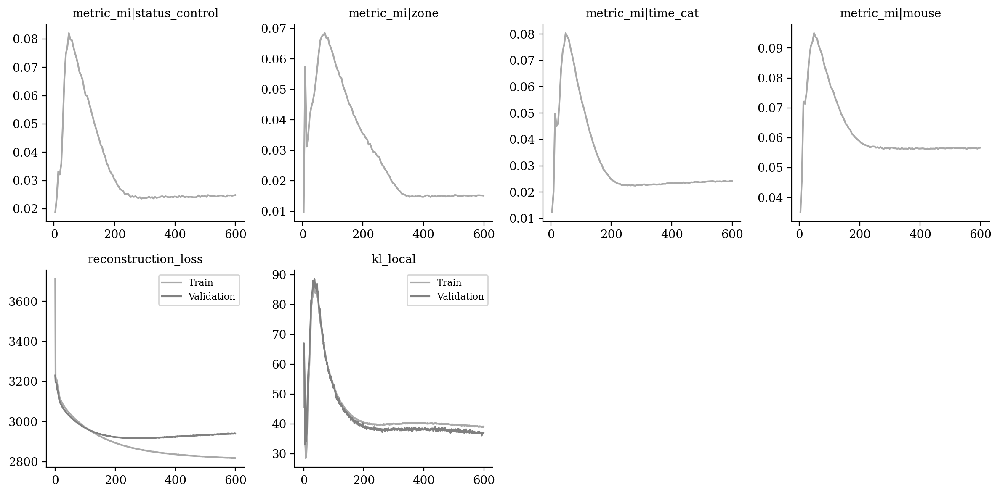

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

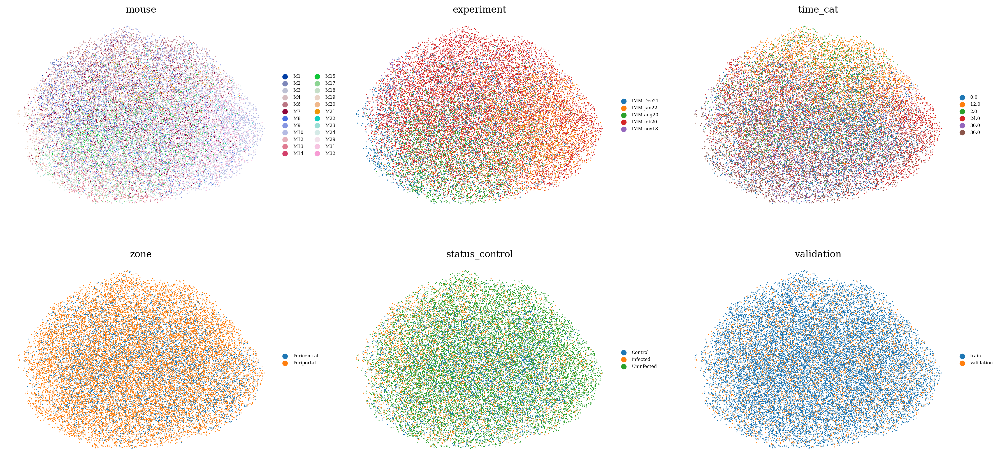

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

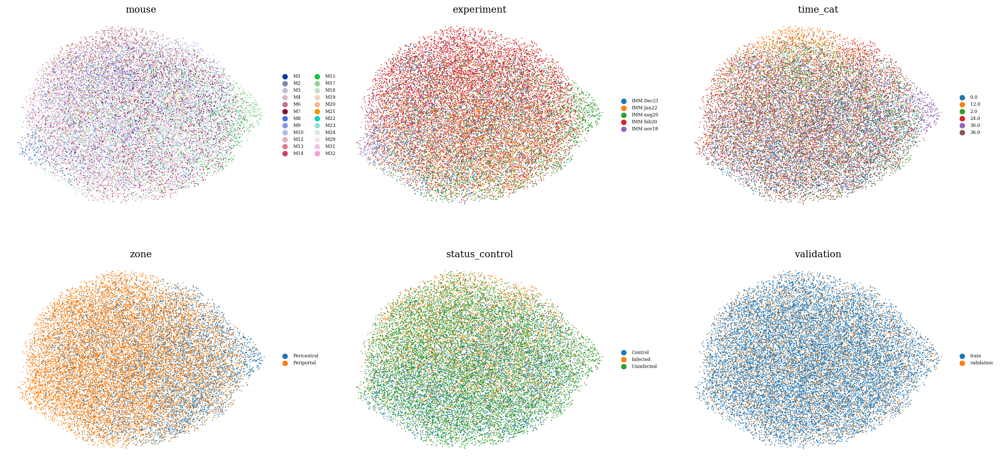

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

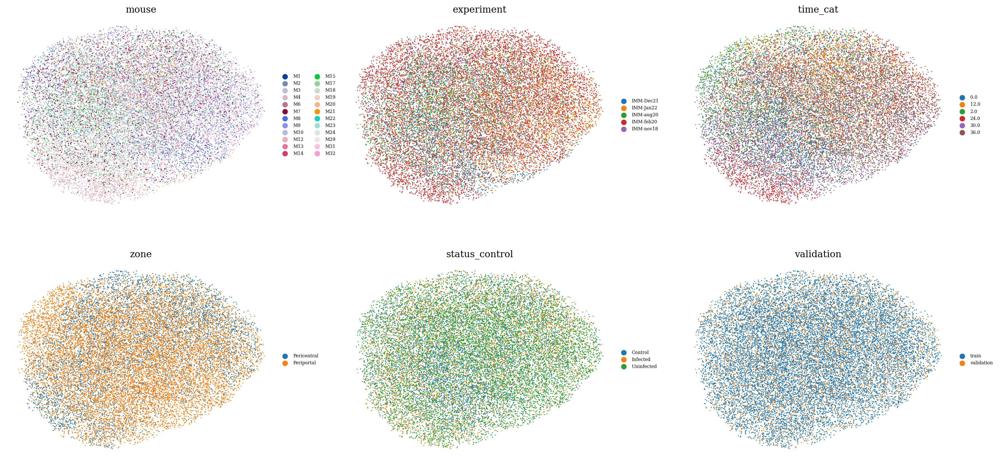

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

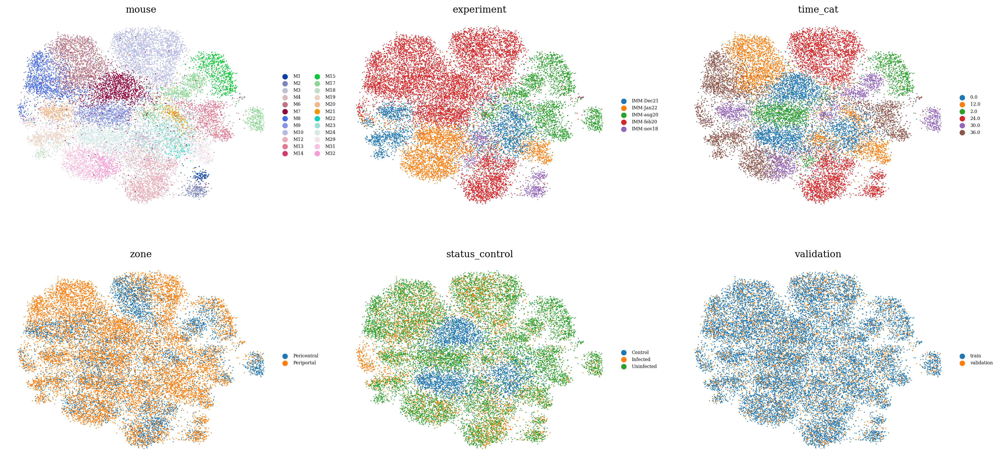

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

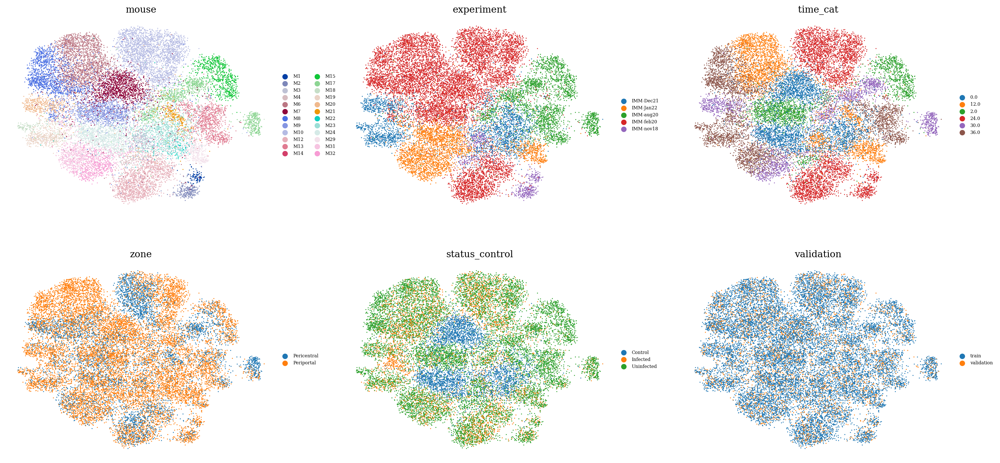

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

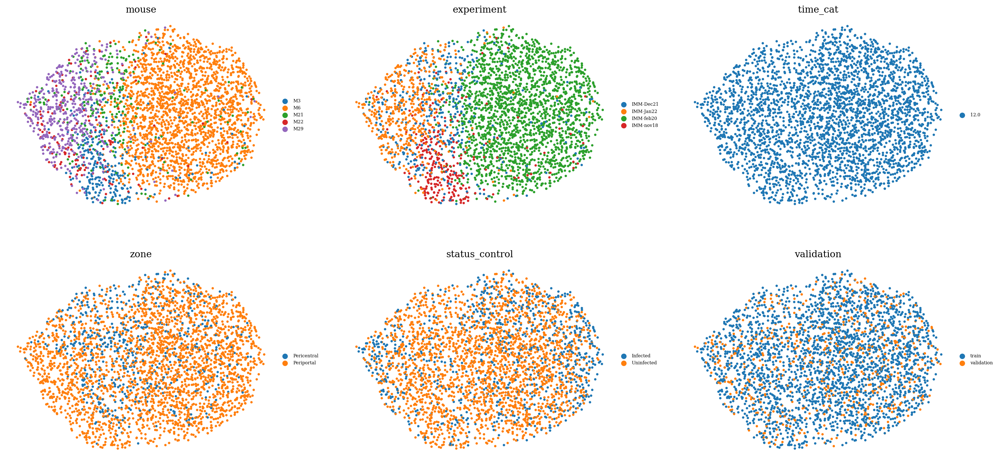

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )